<a href="https://colab.research.google.com/github/Sharmilashree22/Diabetes-prediction-machine-learning-models-/blob/main/diabetes_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

GROUP 5 PROJECT -MACHINE LEARNING

# <font color='black'>Dataset Information:</font>
**<font color='black' size='3'>The Diabetes dataset represents a source of medical and health-related information sourced from 1000 patients in the Iraqi society.</font>**
**<font color='black' size='3'>This dataset was compiled by gathering data from both the Medical City Hospital and the Specialized Center for Endocrinology and Diabetes at Al-Kindy Teaching Hospital.</font>**
**<font color='black' size='3'>The dataset is a comprehensive collection of patient files, consisting of various aspects of laboratory analysis.</font>**

## <font color='black'>Variable Descriptions:</font>
- **<font color='black' size='2'>Age:</font>** Age of the patient (Continuous)
- **<font color='black' size='2'>Urea:</font>** Urea levels in the patient's blood (Continuous)
- **<font color='black' size='2'>Creatinine (Cr):</font>** Serum creatinine concentration (Continuous)
- **<font color='black' size='2'>HbA1c:</font>** Hemoglobin A1c levels, reflecting long-term blood glucose (Continuous)
- **<font color='black' size='2'>Cholesterol (Chol):</font>** Total cholesterol levels (Continuous)
- **<font color='black' size='2'>Triglycerides (TG):</font>** Concentration of triglycerides in the blood (Continuous)
- **<font color='black' size='2'>High-Density Lipoprotein (HDL):</font>** Levels of HDL, often referred to as "good" cholesterol (Continuous)
- **<font color='black' size='2'>Low-Density Lipoprotein (LDL):</font>** Levels of LDL, often referred to as "bad" cholesterol (Continuous)
- **<font color='black' size='2'>Very Low-Density Lipoprotein (VLDL):</font>** Levels of VLDL in the blood (Continuous)
- **<font color='black' size='2'>Body Mass Index (BMI):</font>** A measure of body weight in relation to height (Continuous)
- **<font color='black' size='2'>Gender:</font>** Gender of the patient (Categorical)

## <font color='black'>Response Variable (Target):</font>
- **<font color='black' size='2'>Prediabetic:</font>** Elevated blood sugar, a precursor to diabetes (Categorical)
- **<font color='black' size='2'>Diabetic:</font>** Clinically diagnosed, requiring ongoing care (Categorical)
- **<font color='black' size='2'>Non-Diabetic:</font>** No significant blood sugarded features.</font>**


Importing all Necessary Libraries

In [4]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import classification_report, accuracy_score
from sklearn.model_selection import train_test_split
import xgboost as xgb
import matplotlib.ticker as mtick
import numpy as np
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from scipy.io import arff
import pandas as pd
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import LabelEncoder

In [5]:
import warnings


warnings.filterwarnings("ignore")

Importing necessary modules from Keras for building a neural network model:

In [7]:
pip install seaborn

Reading the dataset :

In [8]:
df = pd.read_csv('Dataset of Diabetes PART1.csv')

Installing and Using missingno Library:
Installing the missingno library to visualize missing data patterns in the dataset.
The missingno library provides a quick and efficient way to visually represent missing values.

In [9]:
pip install missingno

Viewing thr first few rows in the data set :

In [10]:
df.head()

,ID,No_Pation,Gender,AGE,Urea,Cr,HbA1c,Chol,TG,HDL,LDL,VLDL,BMI,CLASS
0,502,17975,F,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,N
1,735,34221,M,26,4.5,62,4.9,3.7,1.4,1.1,2.1,0.6,23.0,N
2,420,47975,F,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,N
3,680,87656,F,50,4.7,46,4.9,4.2,0.9,2.4,1.4,0.5,24.0,N
4,504,34223,M,33,7.1,46,4.9,4.9,1.0,0.8,2.0,0.4,21.0,N


Summary of the dataset :

In [11]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000 entries, 0 to 999
Data columns (total 14 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   ID         1000 non-null   int64  
 1   No_Pation  1000 non-null   int64  
 2   Gender     1000 non-null   object 
 3   AGE        1000 non-null   int64  
 4   Urea       1000 non-null   float64
 5   Cr         1000 non-null   int64  
 6   HbA1c      1000 non-null   float64
 7   Chol       1000 non-null   float64
 8   TG         1000 non-null   float64
 9   HDL        1000 non-null   float64
 10  LDL        1000 non-null   float64
 11  VLDL       1000 non-null   float64
 12  BMI        1000 non-null   float64
 13  CLASS      1000 non-null   object 
dtypes: float64(8), int64(4), object(2)
memory usage: 109.5+ KB


Missing values count per column:
ID           0
No_Pation    0
Gender       0
AGE          0
Urea         0
Cr           0
HbA1c        0
Chol         0
TG           0
HDL          0
LDL          0
VLDL         0
BMI          0
CLASS        0
dtype: int64

Rows with missing values:
Empty DataFrame
Columns: [ID, No_Pation, Gender, AGE, Urea, Cr, HbA1c, Chol, TG, HDL, LDL, VLDL, BMI, CLASS]
Index: []


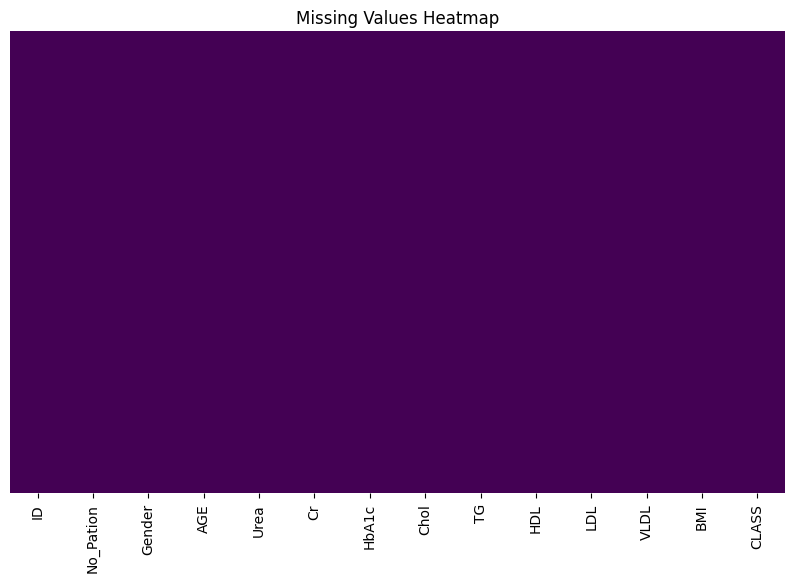

In [12]:
import pandas as pd

missing_values = df.isnull()


print("Missing values count per column:")
print(missing_values.sum())


print("\nRows with missing values:")
print(df[missing_values.any(axis=1)])


import seaborn as sns
plt.figure(figsize=(10, 6))
sns.heatmap(missing_values, cmap='viridis', cbar=False, yticklabels=False)
plt.title('Missing Values Heatmap')
plt.show()


In [13]:
import pandas as pd
from sklearn.impute import SimpleImputer


columns = ["ID", "No_Pation", "Gender", "AGE", "Urea", "Cr", "HbA1c", "Chol", "TG", "HDL", "LDL", "VLDL", "BMI", "CLASS"]
data = df[columns]


imputer = SimpleImputer(strategy='most_frequent')
data['CLASS'] = imputer.fit_transform(data[['CLASS']]).ravel()


missing_values_count = data.isnull().sum()
print("Missing values count per column after handling:")
print(missing_values_count)


color_palette = sns.color_palette("husl", n_colors=len(data['CLASS'].unique()))


sns.set(font_scale=1.2)
plt.figure(figsize=(16, 12))

Missing values count per column after handling:
ID           0
No_Pation    0
Gender       0
AGE          0
Urea         0
Cr           0
HbA1c        0
Chol         0
TG           0
HDL          0
LDL          0
VLDL         0
BMI          0
CLASS        0
dtype: int64


<Figure size 1600x1200 with 0 Axes>

<Figure size 1600x1200 with 0 Axes>

In [14]:
print("Shape of the dataset", df.shape)

Shape of the dataset (1000, 14)


The dataset contains 1000 entries with 14 columns
The memory usage of the DataFrame is approximately 109.5 KB.

In [15]:
duplicate_rows = df[df.duplicated()]
print(duplicate_rows)


Empty DataFrame
Columns: [ID, No_Pation, Gender, AGE, Urea, Cr, HbA1c, Chol, TG, HDL, LDL, VLDL, BMI, CLASS]
Index: []


no duplicate values

In [16]:
df = df.drop(['ID', 'No_Pation'], axis=1)


removed column ID and patient number column

In [17]:
column_names = df.columns.tolist()
print(column_names)


['Gender', 'AGE', 'Urea', 'Cr', 'HbA1c', 'Chol', 'TG', 'HDL', 'LDL', 'VLDL', 'BMI', 'CLASS']


In [18]:
print("Shape of the dataset", df.shape)

Shape of the dataset (1000, 12)


In [19]:
class_counts = df['CLASS'].value_counts()
print("Class Counts:")
print(class_counts)


Class Counts:
CLASS
Y    844
N    103
P     53
Name: count, dtype: int64


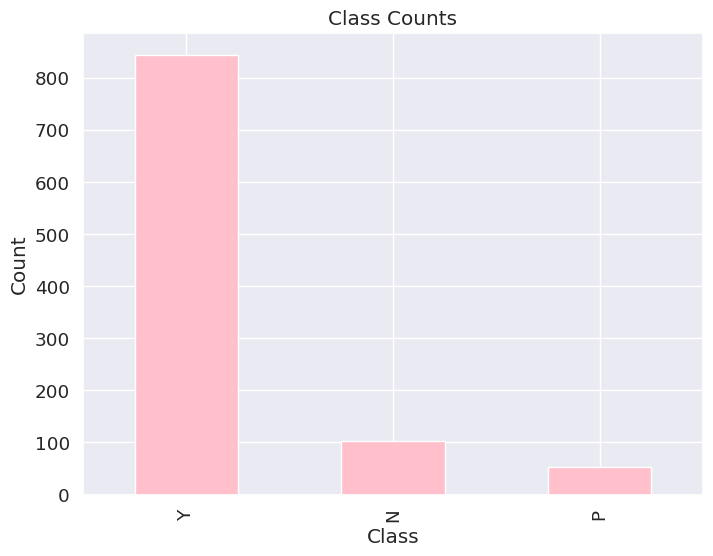

In [20]:
import matplotlib.pyplot as plt


if 'CLASS' in df.columns:
    class_counts = df['CLASS'].value_counts()


    if not class_counts.empty:
        plt.figure(figsize=(8, 6))
        class_counts.plot(kind='bar', color='pink')
        plt.title('Class Counts')
        plt.xlabel('Class')
        plt.ylabel('Count')
        plt.show()
    else:
        print("Class counts DataFrame is empty.")
else:
    print("Column 'CLASS' not found in the DataFrame.")


In [21]:
from sklearn.preprocessing import StandardScaler
columns_to_scale = ['AGE', 'Urea', 'Cr', 'HbA1c', 'Chol', 'TG', 'HDL', 'LDL', 'VLDL', 'BMI']
scaler = StandardScaler()
df[columns_to_scale] = scaler.fit_transform(df[columns_to_scale])


In [22]:
pip install termcolor

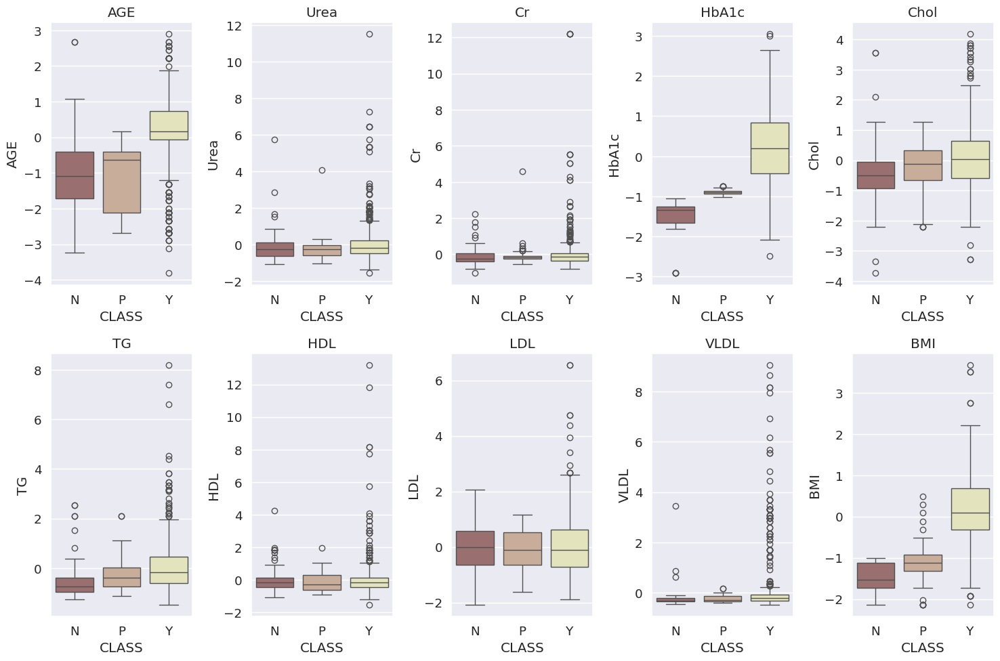

In [23]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(15, 10))

variables = ['AGE', 'Urea', 'Cr', 'HbA1c', 'Chol', 'TG', 'HDL', 'LDL', 'VLDL', 'BMI']

for i, variable in enumerate(variables):
    plt.subplot(2, 5, i + 1)
    sns.boxplot(x='CLASS', y=variable, data=df, palette='pink')
    plt.title(f'{variable}')

plt.tight_layout()
plt.show()

In [24]:
import pandas as pd

print("Before Outlier Replacement:")
print(df[['AGE', 'Urea', 'Cr', 'HbA1c', 'Chol', 'TG', 'HDL', 'LDL', 'VLDL', 'BMI']])


for column in ['AGE', 'Urea', 'Cr', 'HbA1c', 'Chol', 'TG', 'HDL', 'LDL', 'VLDL', 'BMI']:
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1


    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR


    df[column] = df[column].apply(lambda x: lower_bound if x < lower_bound else (upper_bound if x > upper_bound else x))


print("\nAfter Outlier Replacement:")
print(df[['AGE', 'Urea', 'Cr', 'HbA1c', 'Chol', 'TG', 'HDL', 'LDL', 'VLDL', 'BMI']])


df.to_csv('updated_dataset.csv', index=False)


Before Outlier Replacement:
          AGE      Urea        Cr     HbA1c      Chol        TG       HDL  \
0   -0.401144 -0.144781 -0.382672 -1.334983 -0.509436 -1.035084  1.810756   
1   -3.130017 -0.212954 -0.115804 -1.334983 -0.893730 -0.678063 -0.158692   
2   -0.401144 -0.144781 -0.382672 -1.334983 -0.509436 -1.035084  1.810756   
3   -0.401144 -0.144781 -0.382672 -1.334983 -0.509436 -1.035084  1.810756   
4   -2.334096  0.673299 -0.382672 -1.334983  0.028576 -0.963680 -0.613180   
..        ...       ...       ...       ...       ...       ...       ...   
995  1.986619  2.002680  0.467970 -0.505840  2.026906 -0.463850 -0.007196   
996 -2.561502 -0.724254 -0.149162  1.586758 -0.586295 -0.106828 -0.764676   
997 -2.675205  0.673299  0.201102 -0.624289 -0.586295 -0.892276 -0.007196   
998 -1.765581  0.230173 -0.165842 -0.624289  0.336011 -0.249637  0.598788   
999  0.053668 -0.042521 -0.032408 -0.545323 -0.816871 -0.463850 -0.158692   

          LDL      VLDL       BMI  
0   -1.0854

In [25]:
import pandas as pd




print("Before Outlier Replacement:")
print(df[['AGE', 'Urea', 'Cr', 'HbA1c', 'Chol', 'TG', 'HDL', 'LDL', 'VLDL', 'BMI']])


for column in ['AGE', 'Urea', 'Cr', 'HbA1c', 'Chol', 'TG', 'HDL', 'LDL', 'VLDL', 'BMI']:
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1


    lower_bound = Q1 - 3.0 * IQR
    upper_bound = Q3 + 3.0 * IQR


    df[column] = df[column].apply(lambda x: lower_bound if x < lower_bound else (upper_bound if x > upper_bound else x))


print("\nAfter Outlier Replacement:")
print(df[['AGE', 'Urea', 'Cr', 'HbA1c', 'Chol', 'TG', 'HDL', 'LDL', 'VLDL', 'BMI']])


df.to_csv('updated_dataset.csv', index=False)


Before Outlier Replacement:
          AGE      Urea        Cr     HbA1c      Chol        TG       HDL  \
0   -0.401144 -0.144781 -0.382672 -1.334983 -0.509436 -1.035084  1.053276   
1   -1.651878 -0.212954 -0.115804 -1.334983 -0.893730 -0.678063 -0.158692   
2   -0.401144 -0.144781 -0.382672 -1.334983 -0.509436 -1.035084  1.053276   
3   -0.401144 -0.144781 -0.382672 -1.334983 -0.509436 -1.035084  1.053276   
4   -1.651878  0.673299 -0.382672 -1.334983  0.028576 -0.963680 -0.613180   
..        ...       ...       ...       ...       ...       ...       ...   
995  1.986619  1.218686  0.467970 -0.505840  2.026906 -0.463850 -0.007196   
996 -1.651878 -0.724254 -0.149162  1.586758 -0.586295 -0.106828 -0.764676   
997 -1.651878  0.673299  0.201102 -0.624289 -0.586295 -0.892276 -0.007196   
998 -1.651878  0.230173 -0.165842 -0.624289  0.336011 -0.249637  0.598788   
999  0.053668 -0.042521 -0.032408 -0.545323 -0.816871 -0.463850 -0.158692   

          LDL      VLDL       BMI  
0   -1.0854

Before Outlier Replacement:
          AGE      Urea        Cr     HbA1c      Chol        TG       HDL  \
0   -0.401144 -0.144781 -0.382672 -1.334983 -0.509436 -1.035084  1.053276   
1   -1.651878 -0.212954 -0.115804 -1.334983 -0.893730 -0.678063 -0.158692   
2   -0.401144 -0.144781 -0.382672 -1.334983 -0.509436 -1.035084  1.053276   
3   -0.401144 -0.144781 -0.382672 -1.334983 -0.509436 -1.035084  1.053276   
4   -1.651878  0.673299 -0.382672 -1.334983  0.028576 -0.963680 -0.613180   
..        ...       ...       ...       ...       ...       ...       ...   
995  1.986619  1.218686  0.467970 -0.505840  2.026906 -0.463850 -0.007196   
996 -1.651878 -0.724254 -0.149162  1.586758 -0.586295 -0.106828 -0.764676   
997 -1.651878  0.673299  0.201102 -0.624289 -0.586295 -0.892276 -0.007196   
998 -1.651878  0.230173 -0.165842 -0.624289  0.336011 -0.249637  0.598788   
999  0.053668 -0.042521 -0.032408 -0.545323 -0.816871 -0.463850 -0.158692   

          LDL      VLDL       BMI  
0   -1.0854

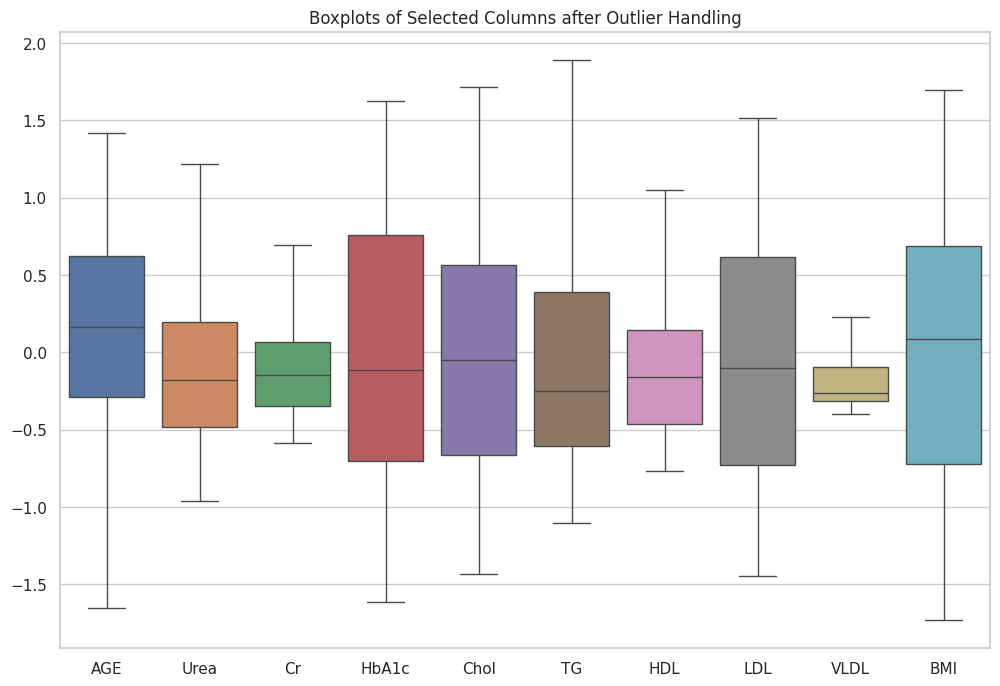

In [26]:
import pandas as pd
from scipy.stats import mstats
import matplotlib.pyplot as plt
import seaborn as sns



print("Before Outlier Replacement:")
print(df[['AGE', 'Urea', 'Cr', 'HbA1c', 'Chol', 'TG', 'HDL', 'LDL', 'VLDL', 'BMI']])


for column in ['AGE', 'Urea', 'Cr', 'HbA1c', 'Chol', 'TG', 'HDL', 'LDL', 'VLDL', 'BMI']:
    df[column] = mstats.winsorize(df[column], limits=[0.05, 0.05])


print("\nAfter Outlier Replacement:")
print(df[['AGE', 'Urea', 'Cr', 'HbA1c', 'Chol', 'TG', 'HDL', 'LDL', 'VLDL', 'BMI']])



plt.figure(figsize=(12, 8))
sns.set(style="whitegrid")
sns.boxplot(data=df[['AGE', 'Urea', 'Cr', 'HbA1c', 'Chol', 'TG', 'HDL', 'LDL', 'VLDL', 'BMI']])
plt.title('Boxplots of Selected Columns after Outlier Handling')
plt.show()


In [27]:




print(df.head())

  Gender       AGE      Urea        Cr     HbA1c      Chol        TG  \
0      F -0.401144 -0.144781 -0.382672 -1.334983 -0.509436 -1.035084   
1      M -1.651878 -0.212954 -0.115804 -1.334983 -0.893730 -0.678063   
2      F -0.401144 -0.144781 -0.382672 -1.334983 -0.509436 -1.035084   
3      F -0.401144 -0.144781 -0.382672 -1.334983 -0.509436 -1.035084   
4      M -1.651878  0.673299 -0.382672 -1.334983  0.028576 -0.963680   

        HDL       LDL      VLDL       BMI CLASS  
0  1.053276 -1.085457 -0.369958 -1.124622     N  
1 -0.158692 -0.457398 -0.342649 -1.326239     N  
2  1.053276 -1.085457 -0.369958 -1.124622     N  
3  1.053276 -1.085457 -0.369958 -1.124622     N  
4 -0.613180 -0.547121 -0.397267 -1.729472     N  


In [28]:
print("Shape of the dataset", df.shape)

Shape of the dataset (1000, 12)


In [29]:

from scipy.stats import zscore


columns_of_interest = ['AGE', 'Urea', 'Cr', 'HbA1c', 'Chol', 'TG', 'HDL', 'LDL', 'VLDL', 'BMI']


def remove_replace_outliers(df, columns):
    df[columns] = df[columns].apply(pd.to_numeric, errors='coerce')
    z_scores = zscore(df[columns])
    threshold = 3.0
    outliers_mask = (z_scores > threshold) | (z_scores < -threshold)
    num_outliers_before = outliers_mask.sum()
    df[outliers_mask] = np.nan
    df.fillna(df.mode().iloc[0], inplace=True)
    num_outliers_after = df.isna().sum().sum()
    return df


df_cleaned = remove_replace_outliers(df, columns_of_interest)


if df_cleaned.isna().sum().sum() == 0:
    print("No outliers left in the DataFrame.")
else:
    print("There are still outliers in the DataFrame.")


No outliers left in the DataFrame.


In [30]:
import pandas as pd
from scipy.stats import skew

selected_columns = ['AGE', 'Urea', 'Cr', 'HbA1c', 'Chol', 'TG', 'HDL', 'LDL', 'VLDL', 'BMI']


skewness = df[selected_columns].apply(lambda x: skew(x))


print("Skewness for each variable:")
for variable, skew_val in skewness.items():
    if skew_val > 0:
        print(f"{variable} is positively skewed")
    elif skew_val < 0:
        print(f"{variable} is negatively skewed")
    else:
        print(f"{variable} is approximately symmetric")

Skewness for each variable:
AGE is negatively skewed
Urea is positively skewed
Cr is positively skewed
HbA1c is positively skewed
Chol is positively skewed
TG is positively skewed
HDL is positively skewed
LDL is positively skewed
VLDL is positively skewed
BMI is negatively skewed


In [31]:
import pandas as pd



selected_columns = ['AGE', 'Urea', 'Cr', 'HbA1c', 'Chol', 'TG', 'HDL', 'LDL', 'VLDL', 'BMI']


correlation_matrix = df[selected_columns].corr()


print("Correlation Matrix:")
print(correlation_matrix)


Correlation Matrix:
            AGE      Urea        Cr     HbA1c      Chol        TG       HDL  \
AGE    1.000000  0.153041  0.068920  0.434613  0.039395  0.168409 -0.035658   
Urea   0.153041  1.000000  0.618707  0.005802  0.001771  0.057660 -0.049322   
Cr     0.068920  0.618707  1.000000 -0.095198 -0.011631  0.057662 -0.058057   
HbA1c  0.434613  0.005802 -0.095198  1.000000  0.156170  0.235074 -0.018138   
Chol   0.039395  0.001771 -0.011631  0.156170  1.000000  0.323473  0.091169   
TG     0.168409  0.057660  0.057662  0.235074  0.323473  1.000000 -0.148828   
HDL   -0.035658 -0.049322 -0.058057 -0.018138  0.091169 -0.148828  1.000000   
LDL   -0.025647 -0.017752  0.060497 -0.024096  0.428238  0.033522 -0.218895   
VLDL  -0.035063  0.010804  0.089288  0.206767  0.216236  0.474731 -0.071043   
BMI    0.423703  0.051095  0.011967  0.435682  0.010978  0.113141  0.060494   

            LDL      VLDL       BMI  
AGE   -0.025647 -0.035063  0.423703  
Urea  -0.017752  0.010804  0.05109

In [32]:
print("Summary Statistics:\n", df.describe())

Summary Statistics:
                AGE         Urea           Cr        HbA1c         Chol  \
count  1000.000000  1000.000000  1000.000000  1000.000000  1000.000000   
mean      0.035248    -0.095988    -0.105354    -0.015754    -0.015295   
std       0.804177     0.575058     0.330790     0.926055     0.841005   
min      -1.651878    -0.962861    -0.582823    -1.611364    -1.431742   
25%      -0.287441    -0.485648    -0.349313    -0.703255    -0.663153   
50%       0.167371    -0.178867    -0.149162    -0.111010    -0.048283   
75%       0.622183     0.196086     0.067668     0.757616     0.566588   
max       1.418104     1.218686     0.693139     1.626241     1.719471   

                TG          HDL          LDL         VLDL          BMI  
count  1000.000000  1000.000000  1000.000000  1000.000000  1000.000000  
mean     -0.044556    -0.085141    -0.039038    -0.193923    -0.009422  
std       0.815240     0.512955     0.853827     0.169844     0.957814  
min      -1.106489  

Statistical testing :

shapiro


In [33]:
from scipy.stats import shapiro

variables_of_interest = ['AGE', 'Urea', 'Cr', 'HbA1c', 'Chol', 'TG', 'HDL', 'LDL', 'VLDL', 'BMI']

for variable in variables_of_interest:
    stat, p_value = shapiro(df[variable])
    print(f"Shapiro-Wilk test for {variable}: Statistic = {stat}, p-value = {p_value}")

    if p_value > 0.05:
        print(f"The data for {variable} appears to be normally distributed.")
    else:
        print(f"The data for {variable} does not appear to be normally distributed.")
    print("\n")


Shapiro-Wilk test for AGE: Statistic = 0.9297565659890685, p-value = 3.052752016465236e-21
The data for AGE does not appear to be normally distributed.


Shapiro-Wilk test for Urea: Statistic = 0.9367757463461936, p-value = 3.506589929562131e-20
The data for Urea does not appear to be normally distributed.


Shapiro-Wilk test for Cr: Statistic = 0.9442439210377261, p-value = 5.922597043462791e-19
The data for Cr does not appear to be normally distributed.


Shapiro-Wilk test for HbA1c: Statistic = 0.9667323402245976, p-value = 2.3983445153106688e-14
The data for HbA1c does not appear to be normally distributed.


Shapiro-Wilk test for Chol: Statistic = 0.9712887135441365, p-value = 3.6801117565973403e-13
The data for Chol does not appear to be normally distributed.


Shapiro-Wilk test for TG: Statistic = 0.9046919602916909, p-value = 1.7647919344414033e-24
The data for TG does not appear to be normally distributed.


Shapiro-Wilk test for HDL: Statistic = 0.9127022689349678, p-value = 

Anderson-Darling test

In [34]:
from scipy.stats import anderson

variables_of_interest = ['AGE', 'Urea', 'Cr', 'HbA1c', 'Chol', 'TG', 'HDL', 'LDL', 'VLDL', 'BMI']

for variable in variables_of_interest:
    result = anderson(df[variable])
    print(f"Anderson-Darling test for {variable}: Statistic = {result.statistic}, Critical Values = {result.critical_values}, Significance Level = {result.significance_level}")

    if result.statistic < result.critical_values[2]:
        print(f"The data for {variable} appears to be normally distributed.")
    else:
        print(f"The data for {variable} does not appear to be normally distributed.")
    print("\n")


Anderson-Darling test for AGE: Statistic = 23.093311062024213, Critical Values = [0.574 0.653 0.784 0.914 1.088], Significance Level = [15.  10.   5.   2.5  1. ]
The data for AGE does not appear to be normally distributed.


Anderson-Darling test for Urea: Statistic = 15.723876342014819, Critical Values = [0.574 0.653 0.784 0.914 1.088], Significance Level = [15.  10.   5.   2.5  1. ]
The data for Urea does not appear to be normally distributed.


Anderson-Darling test for Cr: Statistic = 11.685179181512694, Critical Values = [0.574 0.653 0.784 0.914 1.088], Significance Level = [15.  10.   5.   2.5  1. ]
The data for Cr does not appear to be normally distributed.


Anderson-Darling test for HbA1c: Statistic = 6.0900775476809486, Critical Values = [0.574 0.653 0.784 0.914 1.088], Significance Level = [15.  10.   5.   2.5  1. ]
The data for HbA1c does not appear to be normally distributed.


Anderson-Darling test for Chol: Statistic = 4.874871643020697, Critical Values = [0.574 0.653 0.

 Q-Q plot

In [35]:
pip install numpy matplotlib scipy


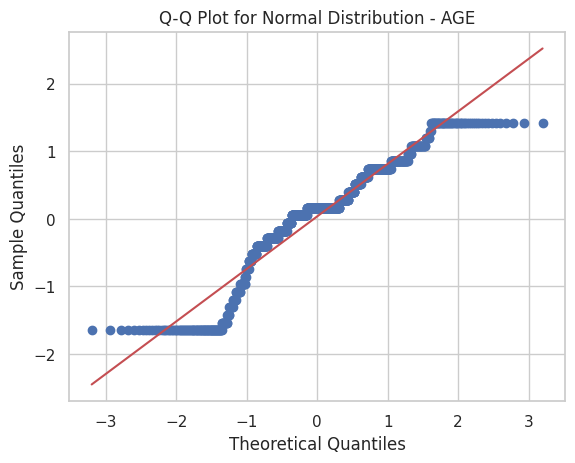

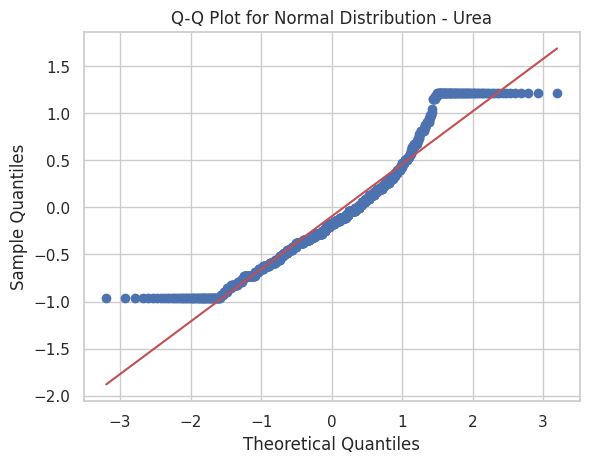

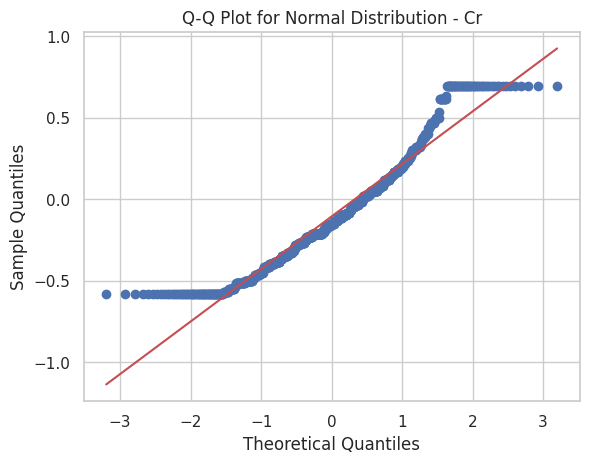

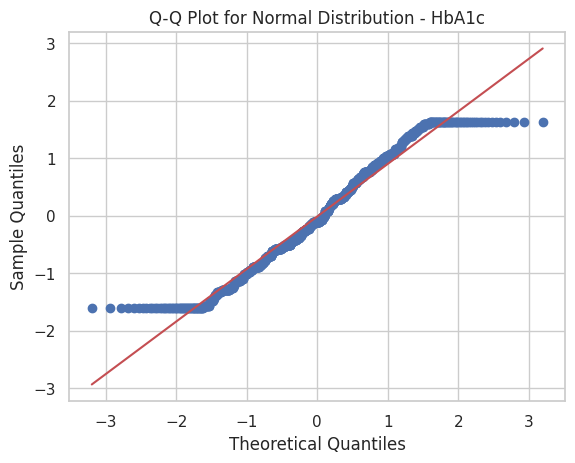

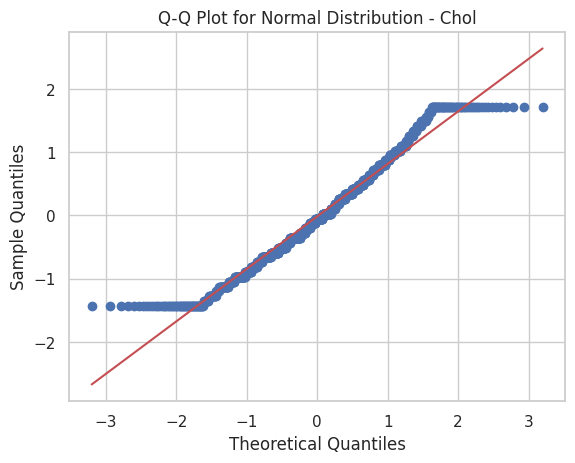

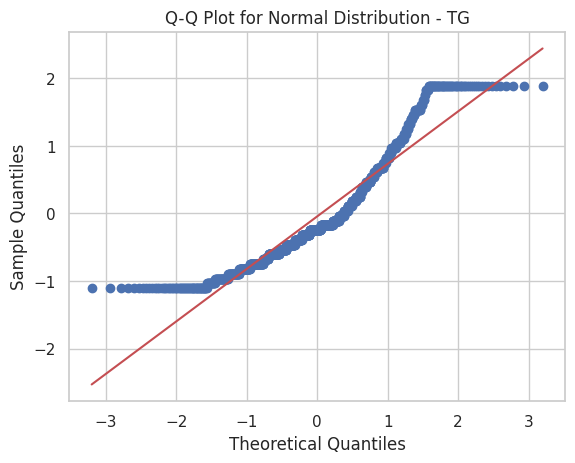

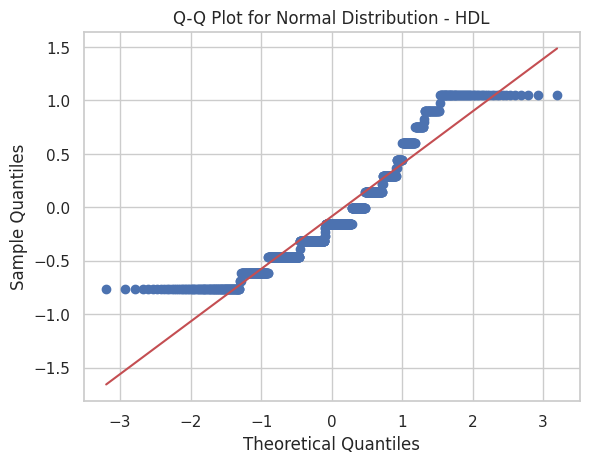

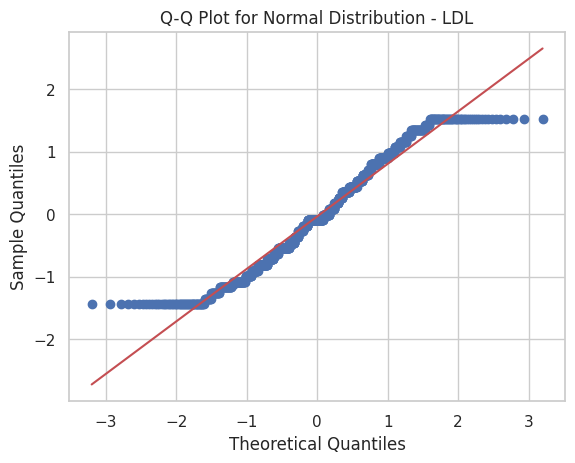

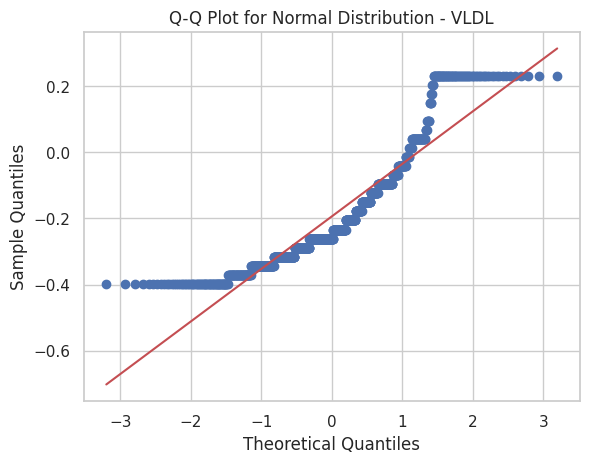

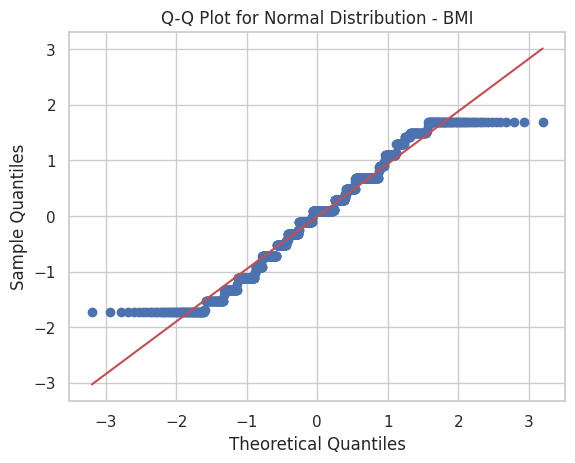

In [36]:
import pandas as pd
import matplotlib.pyplot as plt
from scipy import stats



numerical_columns = df.select_dtypes(include=['float64', 'int64']).columns
for numerical_column in numerical_columns:

    your_data = pd.to_numeric(df[numerical_column], errors='coerce').dropna().values


    stats.probplot(your_data, dist="norm", plot=plt)

    plt.title(f"Q-Q Plot for Normal Distribution - {numerical_column}")
    plt.xlabel("Theoretical Quantiles")
    plt.ylabel("Sample Quantiles")
    plt.show()


Skewness Values:
AGE     -0.613357
Urea     0.733010
Cr       0.700977
HbA1c    0.096458
Chol     0.298005
TG       0.930829
HDL      0.776545
LDL      0.153885
VLDL     1.163165
BMI     -0.018109
dtype: float64


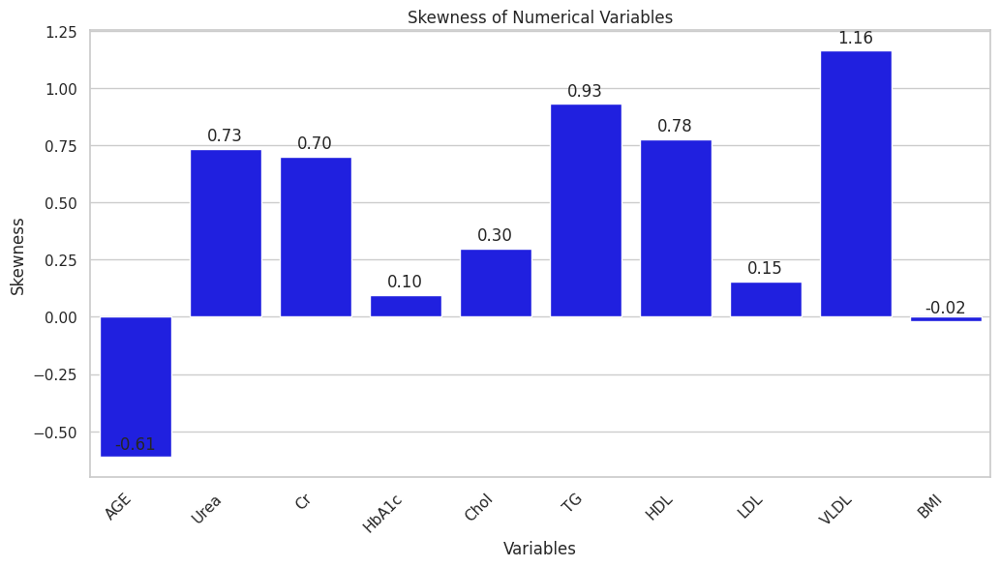

In [37]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt





numerical_columns = df.select_dtypes(include=['float64', 'int64']).columns


skewness_values = df[numerical_columns].skew()


print("Skewness Values:")
print(skewness_values)


plt.figure(figsize=(12, 6))
ax = sns.barplot(x=skewness_values.index, y=skewness_values.values, color='blue')
plt.title('Skewness of Numerical Variables')
plt.xlabel('Variables')
plt.ylabel('Skewness')
plt.xticks(rotation=45, ha='right')


for i, v in enumerate(skewness_values.values):
    ax.text(i, v + 0.02, f'{v:.2f}', ha='center', va='bottom')

plt.show()



AGE: The dataset contains a slight bias towards a younger population.
Urea, Cr, TG, LDL, VLDL: These variables exhibit a concentration of lower values with extended tails towards higher values, indicating potential outliers or extreme values.
HDL: Strong concentration of higher values with a long tail on the lower side suggests a majority of healthier individuals with higher HDL levels.
HbA1c, Chol, BMI: These variables are slightly concentrated on the lower side, indicating a tendency towards lower levels for HbA1c and Cholesterol, and a slightly lower BMI on average.

In [38]:
from scipy.stats import chi2_contingency


In [39]:




contingency_table = pd.crosstab(df['Gender'], df['CLASS'])


chi2, p, dof, expected = chi2_contingency(contingency_table)


print(f"Chi-square value: {chi2}")
print(f"P-value: {p}")
print(f"Degrees of freedom: {dof}")
print("Expected frequencies table:")
print(expected)

Chi-square value: 18.2015805746043
P-value: 0.00011157759528106132
Degrees of freedom: 2
Expected frequencies table:
[[ 44.805  23.055 367.14 ]
 [ 58.195  29.945 476.86 ]]


In [40]:
import numpy as np
import pandas as pd
from scipy.stats import chi2_contingency


observed = pd.crosstab(df['Gender'], df['CLASS'])


chi2, p, _, _ = chi2_contingency(observed)


n = np.sum(observed)


cramers_v = np.sqrt(chi2 / (n * (min(observed.shape) - 1)))

print(f"Chi-square value: {chi2}")
print(f"P-value: {p}")
print(f"Cramér's V: {cramers_v.iloc[0]:.4f}")



Chi-square value: 18.2015805746043
P-value: 0.00011157759528106132
Cramér's V: 0.4204


The Chi-square test indicates that there is a statistically significant association between 'Gender' and 'CLASS' (p-value < 0.05).
Cramér's V suggests a moderate effect size, meaning there is a moderate practical significance in the association between 'Gender' and 'CLASS'.

In [41]:
df_encoded = pd.get_dummies(df, columns=['Gender'], drop_first=True)


print(df_encoded)

          AGE      Urea        Cr     HbA1c      Chol        TG       HDL  \
0   -0.401144 -0.144781 -0.382672 -1.334983 -0.509436 -1.035084  1.053276   
1   -1.651878 -0.212954 -0.115804 -1.334983 -0.893730 -0.678063 -0.158692   
2   -0.401144 -0.144781 -0.382672 -1.334983 -0.509436 -1.035084  1.053276   
3   -0.401144 -0.144781 -0.382672 -1.334983 -0.509436 -1.035084  1.053276   
4   -1.651878  0.673299 -0.382672 -1.334983  0.028576 -0.963680 -0.613180   
..        ...       ...       ...       ...       ...       ...       ...   
995  1.418104  1.218686  0.467970 -0.505840  1.719471 -0.463850 -0.007196   
996 -1.651878 -0.724254 -0.149162  1.586758 -0.586295 -0.106828 -0.764676   
997 -1.651878  0.673299  0.201102 -0.624289 -0.586295 -0.892276 -0.007196   
998 -1.651878  0.230173 -0.165842 -0.624289  0.336011 -0.249637  0.598788   
999  0.053668 -0.042521 -0.032408 -0.545323 -0.816871 -0.463850 -0.158692   

          LDL      VLDL       BMI CLASS  Gender_M  
0   -1.085457 -0.369958

#Since the p-value is 0.0034,
#which is less than the commonly used significance level of 0.05, you would reject the null hypothesis. This suggests that there is evidence to conclude that there is a significant association between "Gender" and "Class" in your dataset.

Based on the normality test the data is not normally distributed
so, we will proceeded with non parametric testing

Variables in order of significance (from highly significant to lowest):
1. HbA1c: p-value = 1.794915249707218e-73
2. BMI: p-value = 2.4194447574781393e-71
3. AGE: p-value = 5.175151182133636e-51
4. TG: p-value = 2.6079222269250917e-14
5. VLDL: p-value = 1.0940276215645388e-12
6. Chol: p-value = 1.786073669644074e-08
7. Gender: p-value = 0.00011259767429846746
8. Urea: p-value = 0.015481261666513597
9. Cr: p-value = 0.3351360796997876
10. HDL: p-value = 0.5514997357700726
11. LDL: p-value = 0.8212126777347142


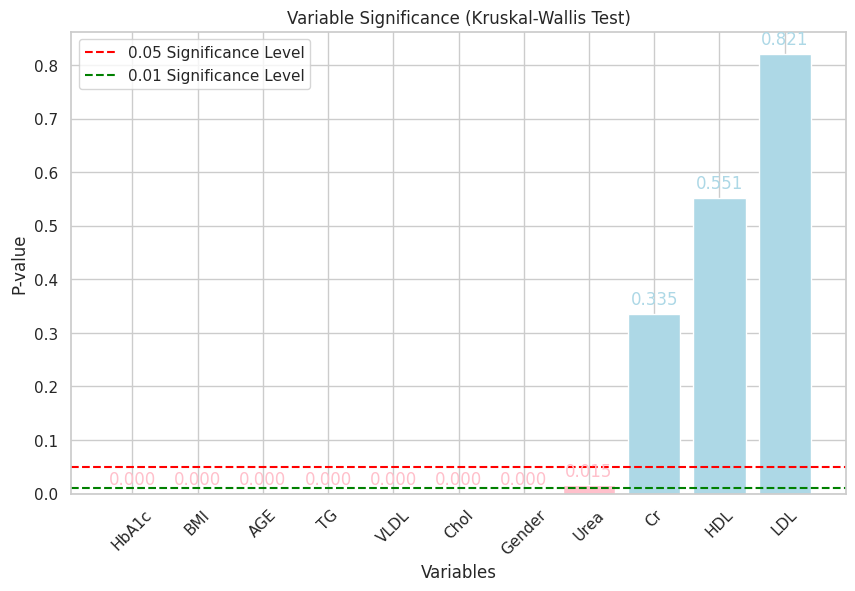

In [42]:
from scipy.stats import kruskal


class_n = df[df['CLASS'] == 'N']
class_y = df[df['CLASS'] == 'Y']
class_p = df[df['CLASS'] == 'P']


variables_to_test = ['AGE', 'Urea', 'Cr', 'HbA1c', 'Chol', 'TG', 'HDL', 'LDL', 'VLDL', 'BMI','Gender']


p_values = {}


for variable in variables_to_test:
    h_statistic, p_value = kruskal(class_n[variable], class_y[variable], class_p[variable])
    p_values[variable] = p_value


sorted_variables = sorted(p_values, key=p_values.get)


print("Variables in order of significance (from highly significant to lowest):")
for i, variable in enumerate(sorted_variables):
    print(f"{i+1}. {variable}: p-value = {p_values[variable]}")


plt.figure(figsize=(10, 6))
bar_colors = ['pink' if p_values[variable] < 0.05 else 'lightblue' for variable in sorted_variables]
bars = plt.bar(range(len(p_values)), [p_values[variable] for variable in sorted_variables], align='center', color=bar_colors)
plt.xticks(range(len(p_values)), sorted_variables, rotation=45)
plt.xlabel('Variables')
plt.ylabel('P-value')
plt.title('Variable Significance (Kruskal-Wallis Test)')


plt.axhline(y=0.05, color='red', linestyle='--', label='0.05 Significance Level')
plt.axhline(y=0.01, color='green', linestyle='--', label='0.01 Significance Level')


for bar, color in zip(bars, bar_colors):
    height = bar.get_height()
    plt.text(bar.get_x() + bar.get_width() / 2, height + 0.01, f"{height:.3f}", ha='center', va='bottom', color=color)


plt.legend()

plt.show()


Based on the above test result,HBA1C,AGE AND BMI IS HIGHLY SIGNIFICANT

Data visualisation

In [ ]:
pip install --upgrade seaborn


Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python3 -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


In [ ]:
pip show seaborn


Name: seaborn
Version: 0.13.0
Summary: Statistical data visualization
Home-page: 
Author: 
Author-email: Michael Waskom <mwaskom@gmail.com>
License: 
Location: /home/students/vsha/.local/lib/python3.10/site-packages
Requires: matplotlib, numpy, pandas
Required-by: missingno, ydata-profiling
Note: you may need to restart the kernel to use updated packages.


<Figure size 1600x1200 with 0 Axes>

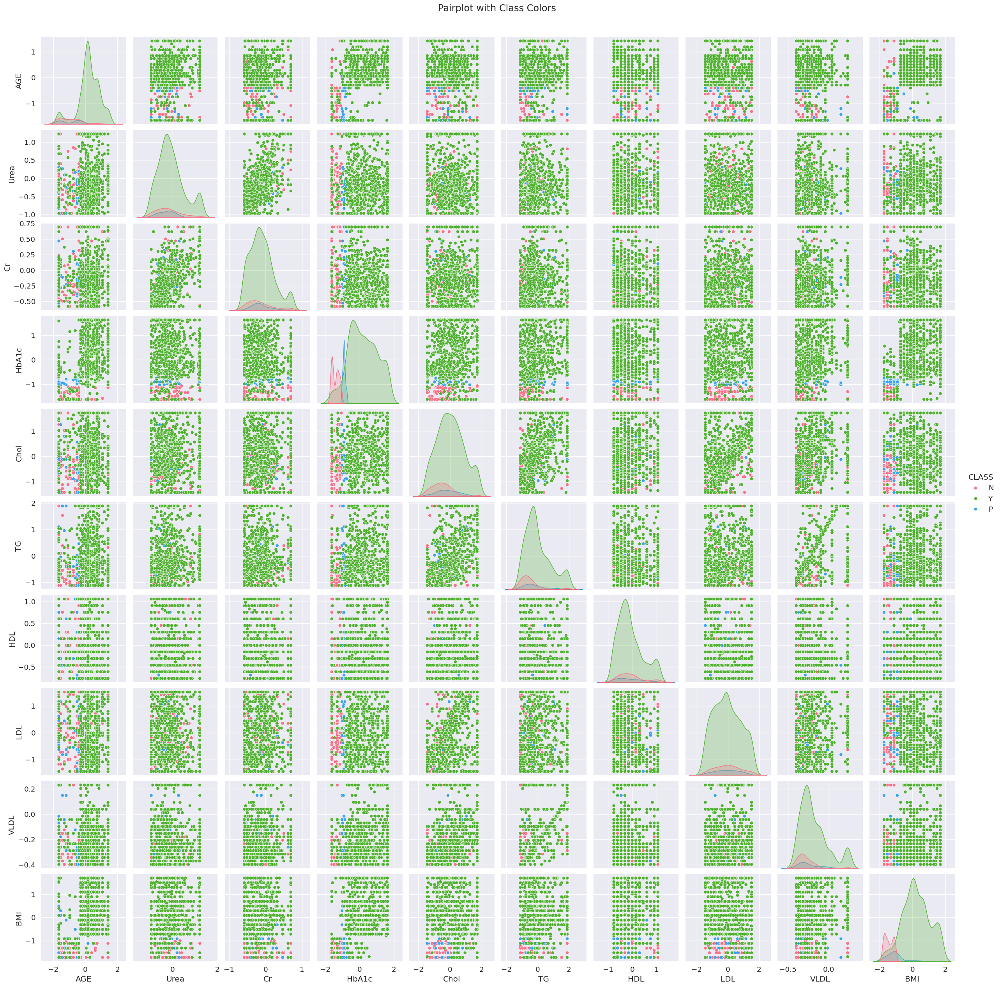

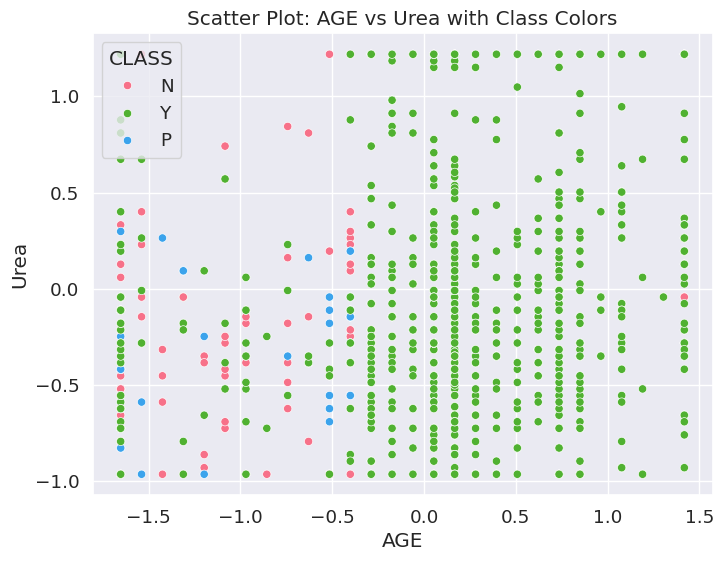

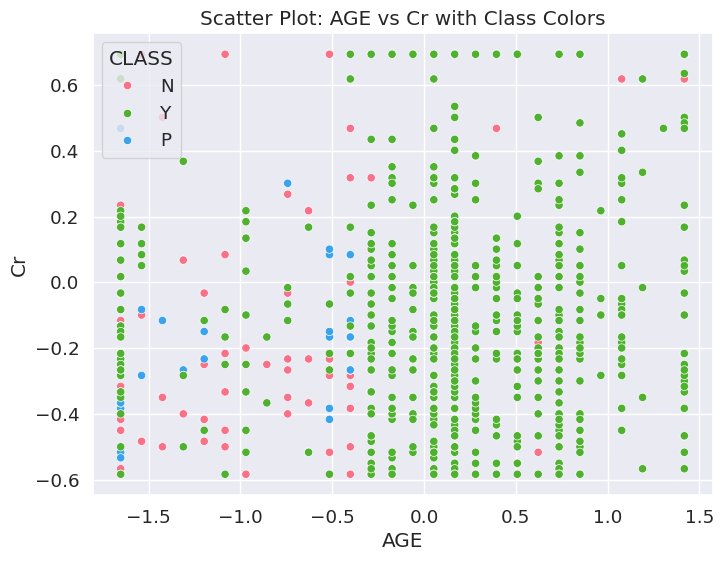

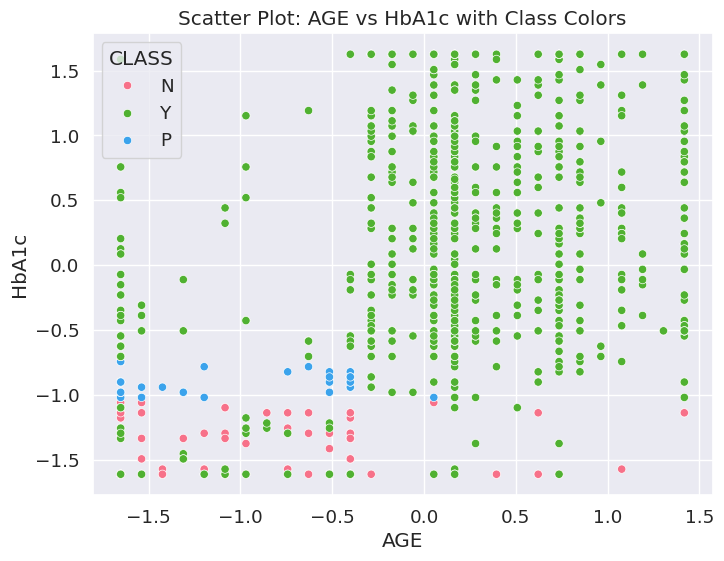

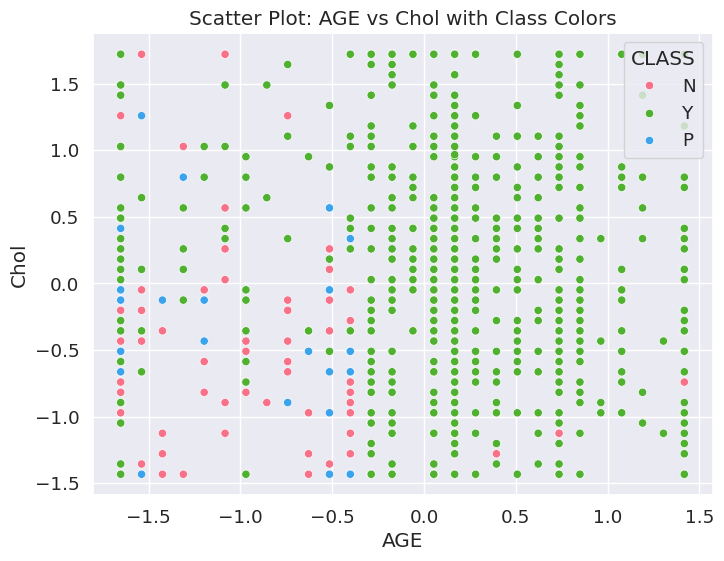

...

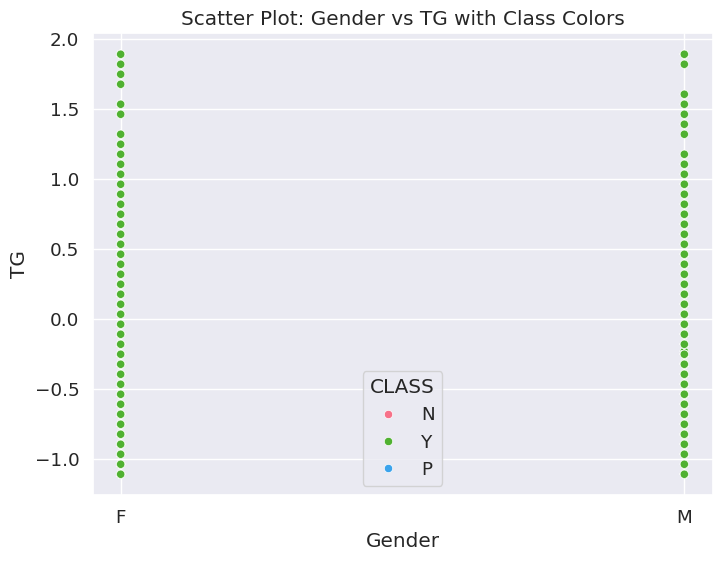

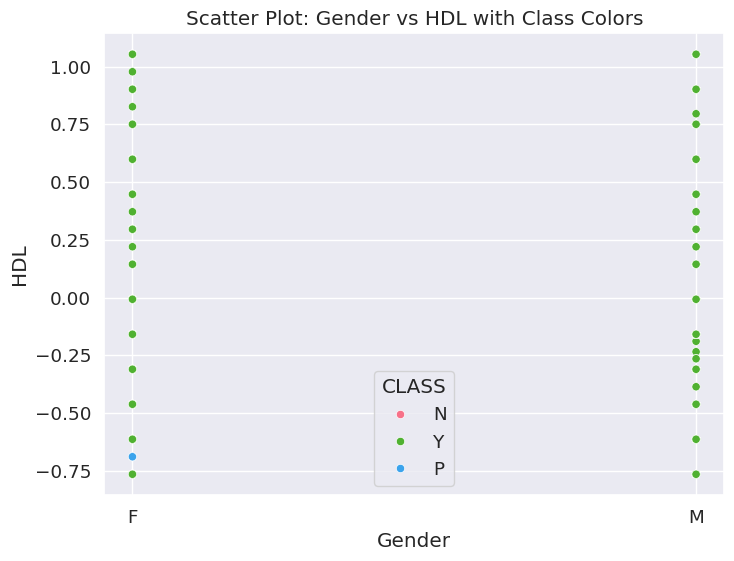

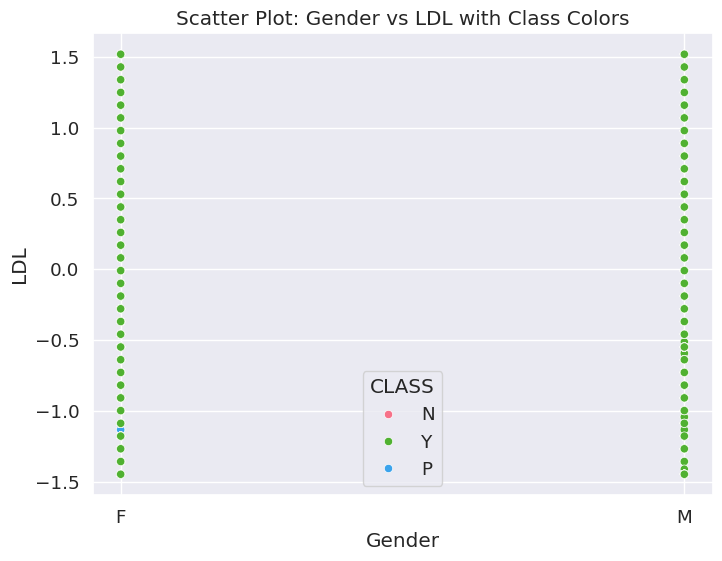

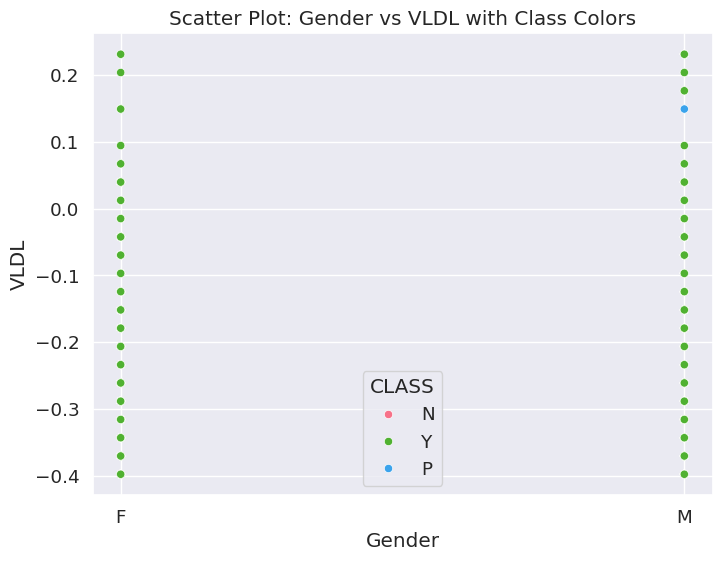

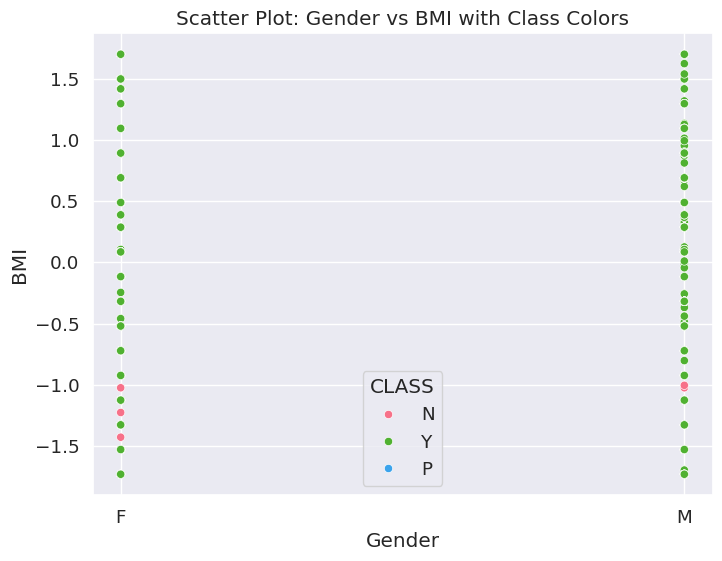

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


columns = ["CLASS", "AGE", "Urea", "Cr", "HbA1c", "Chol", "TG", "HDL", "LDL", "VLDL", "BMI", "Gender"]
data = df[columns]


data['CLASS'] = data['CLASS'].str.strip()


color_palette = sns.color_palette("husl", n_colors=len(data['CLASS'].unique()))


sns.set(font_scale=1.2)
plt.figure(figsize=(16, 12))


pairplot = sns.pairplot(data, hue='CLASS', palette=color_palette, diag_kind='kde')


plt.suptitle('Pairplot with Class Colors', y=1.02)
plt.show()

for i, var1 in enumerate(columns[1:]):
    for j, var2 in enumerate(columns[1:]):
        if i != j:
            plt.figure(figsize=(8, 6))
            sns.scatterplot(data=data, x=var1, y=var2, hue='CLASS', palette=color_palette)
            plt.title(f'Scatter Plot: {var1} vs {var2} with Class Colors')
            plt.show()


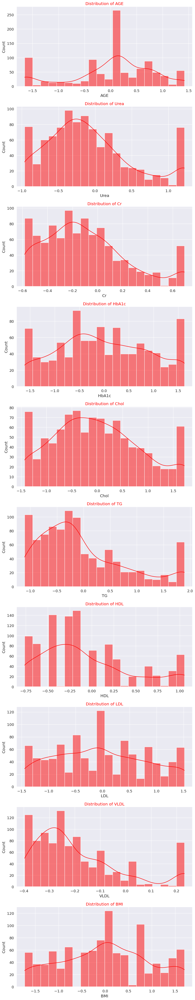

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np

numeric_columns = df.select_dtypes(include=[np.number]).columns


fig, axes = plt.subplots(nrows=len(numeric_columns), ncols=1, figsize=(10, 5 * len(numeric_columns)))

for i, col in enumerate(numeric_columns):
    sns.histplot(df[col], ax=axes[i], kde=True, bins=20, color='red')
    axes[i].set_title(f'Distribution of {col}', color='red')  # Set title color to red

plt.tight_layout()
plt.show()


Variable: BMI
Mean values:
CLASS=N: -1.4357443120541102
CLASS=P: -1.101797518962588
CLASS=Y: 0.23126584541807743


Variable: HbA1c
Mean values:
CLASS=N: -1.397691588438497
CLASS=P: -0.8991804084835361
CLASS=Y: 0.20647028153023494


Variable: AGE
Mean values:
CLASS=N: -0.8871690142007662
CLASS=P: -0.9610780876327837
CLASS=Y: 0.20908439965266154




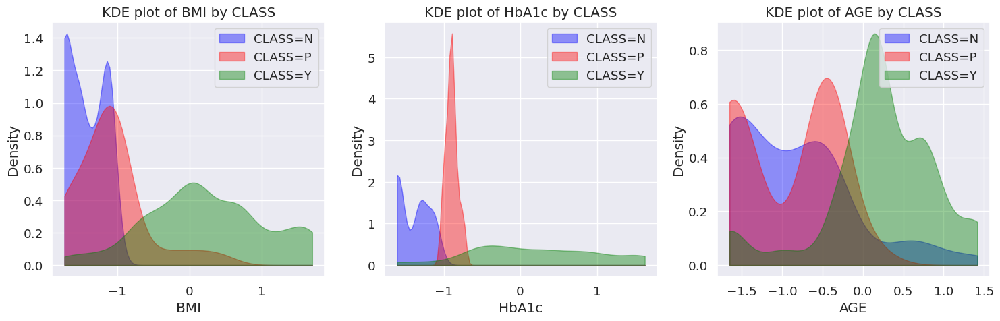

In [ ]:
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

variables_to_plot = [ 'BMI', 'HbA1c', 'AGE']


num_columns = len(variables_to_plot)
num_rows = 1


plt.figure(figsize=(15, 5 * num_rows))

for i, variable in enumerate(variables_to_plot):
    plt.subplot(num_rows, num_columns, i + 1)


    kde_class_N = gaussian_kde(df[df['CLASS'] == 'N'][variable])
    kde_class_P = gaussian_kde(df[df['CLASS'] == 'P'][variable])
    kde_class_Y = gaussian_kde(df[df['CLASS'] == 'Y'][variable])

    x = np.linspace(df[variable].min(), df[variable].max(), 100)
    y_class_N = kde_class_N(x)
    y_class_P = kde_class_P(x)
    y_class_Y = kde_class_Y(x)


    plt.fill_between(x, y_class_N, alpha=0.4, label='CLASS=N', color='blue')


    plt.fill_between(x, y_class_P, alpha=0.4, label='CLASS=P', color='red')


    plt.fill_between(x, y_class_Y, alpha=0.4, label='CLASS=Y', color='green')

    plt.title(f'KDE plot of {variable} by CLASS')
    plt.xlabel(variable)
    plt.ylabel('Density')
    plt.legend()


    print(f"Variable: {variable}")
    print("Mean values:")
    print(f"CLASS=N: {df[df['CLASS'] == 'N'][variable].mean()}")
    print(f"CLASS=P: {df[df['CLASS'] == 'P'][variable].mean()}")
    print(f"CLASS=Y: {df[df['CLASS'] == 'Y'][variable].mean()}")
    print("\n")

plt.tight_layout()
plt.show()


Variable: Urea
Mean values:
CLASS=N: -0.2126199478994206
CLASS=P: -0.2605468504048468
CLASS=Y: -0.07158800687713719


Variable: Cr
Mean values:
CLASS=N: -0.13109331605734664
CLASS=P: -0.1213113052639659
CLASS=Y: -0.10124667662389535


Variable: Chol
Mean values:
CLASS=N: -0.4589500631124061
CLASS=P: -0.1613957360715258
CLASS=Y: 0.047422450896557014




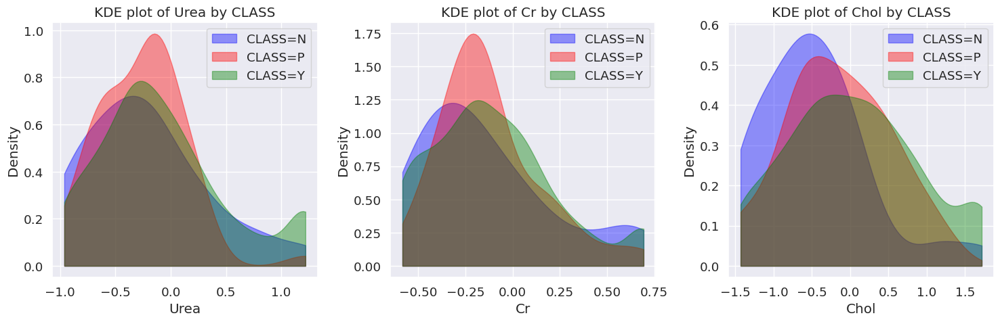

In [ ]:
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

variables_to_plot = [ 'Urea', 'Cr', 'Chol',]


num_columns = len(variables_to_plot)
num_rows = 1


plt.figure(figsize=(15, 5 * num_rows))

for i, variable in enumerate(variables_to_plot):
    plt.subplot(num_rows, num_columns, i + 1)


    kde_class_N = gaussian_kde(df[df['CLASS'] == 'N'][variable])
    kde_class_P = gaussian_kde(df[df['CLASS'] == 'P'][variable])
    kde_class_Y = gaussian_kde(df[df['CLASS'] == 'Y'][variable])

    x = np.linspace(df[variable].min(), df[variable].max(), 100)
    y_class_N = kde_class_N(x)
    y_class_P = kde_class_P(x)
    y_class_Y = kde_class_Y(x)


    plt.fill_between(x, y_class_N, alpha=0.4, label='CLASS=N', color='blue')


    plt.fill_between(x, y_class_P, alpha=0.4, label='CLASS=P', color='red')


    plt.fill_between(x, y_class_Y, alpha=0.4, label='CLASS=Y', color='green')

    plt.title(f'KDE plot of {variable} by CLASS')
    plt.xlabel(variable)
    plt.ylabel('Density')
    plt.legend()


    print(f"Variable: {variable}")
    print("Mean values:")
    print(f"CLASS=N: {df[df['CLASS'] == 'N'][variable].mean()}")
    print(f"CLASS=P: {df[df['CLASS'] == 'P'][variable].mean()}")
    print(f"CLASS=Y: {df[df['CLASS'] == 'Y'][variable].mean()}")
    print("\n")

plt.tight_layout()
plt.show()


Variable: TG
Mean values:
CLASS=N: -0.5212531622830232
CLASS=P: -0.16745434027474201
CLASS=Y: 0.020694200639041937


Variable: HDL
Mean values:
CLASS=N: -0.044327442878397724
CLASS=P: -0.12296189997388421
CLASS=Y: -0.08769513842327732


Variable: LDL
Mean values:
CLASS=N: -0.008783860929447116
CLASS=P: -0.1010459729526658
CLASS=Y: -0.03880117705028938


Variable: VLDL
Mean values:
CLASS=N: -0.2866916506713763
CLASS=P: -0.23804931356179357
CLASS=Y: -0.17995692966960652




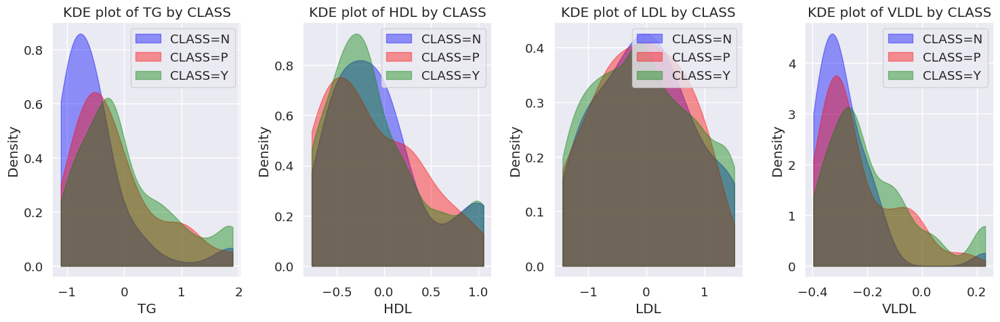

In [ ]:
import matplotlib.pyplot as plt
from scipy.stats import gaussian_kde

variables_to_plot = ['TG', 'HDL', 'LDL', 'VLDL', ]


num_columns = len(variables_to_plot)
num_rows = 1


plt.figure(figsize=(15, 5 * num_rows))

for i, variable in enumerate(variables_to_plot):
    plt.subplot(num_rows, num_columns, i + 1)


    kde_class_N = gaussian_kde(df[df['CLASS'] == 'N'][variable])
    kde_class_P = gaussian_kde(df[df['CLASS'] == 'P'][variable])
    kde_class_Y = gaussian_kde(df[df['CLASS'] == 'Y'][variable])

    x = np.linspace(df[variable].min(), df[variable].max(), 100)
    y_class_N = kde_class_N(x)
    y_class_P = kde_class_P(x)
    y_class_Y = kde_class_Y(x)


    plt.fill_between(x, y_class_N, alpha=0.4, label='CLASS=N', color='blue')


    plt.fill_between(x, y_class_P, alpha=0.4, label='CLASS=P', color='red')


    plt.fill_between(x, y_class_Y, alpha=0.4, label='CLASS=Y', color='green')

    plt.title(f'KDE plot of {variable} by CLASS')
    plt.xlabel(variable)
    plt.ylabel('Density')
    plt.legend()


    print(f"Variable: {variable}")
    print("Mean values:")
    print(f"CLASS=N: {df[df['CLASS'] == 'N'][variable].mean()}")
    print(f"CLASS=P: {df[df['CLASS'] == 'P'][variable].mean()}")
    print(f"CLASS=Y: {df[df['CLASS'] == 'Y'][variable].mean()}")
    print("\n")

plt.tight_layout()
plt.show()


Correlation heatmap:

In [ ]:
non_numeric_columns = df.select_dtypes(exclude=[np.number]).columns
print("Non-numeric columns:", non_numeric_columns)


Non-numeric columns: Index(['Gender', 'CLASS'], dtype='object')


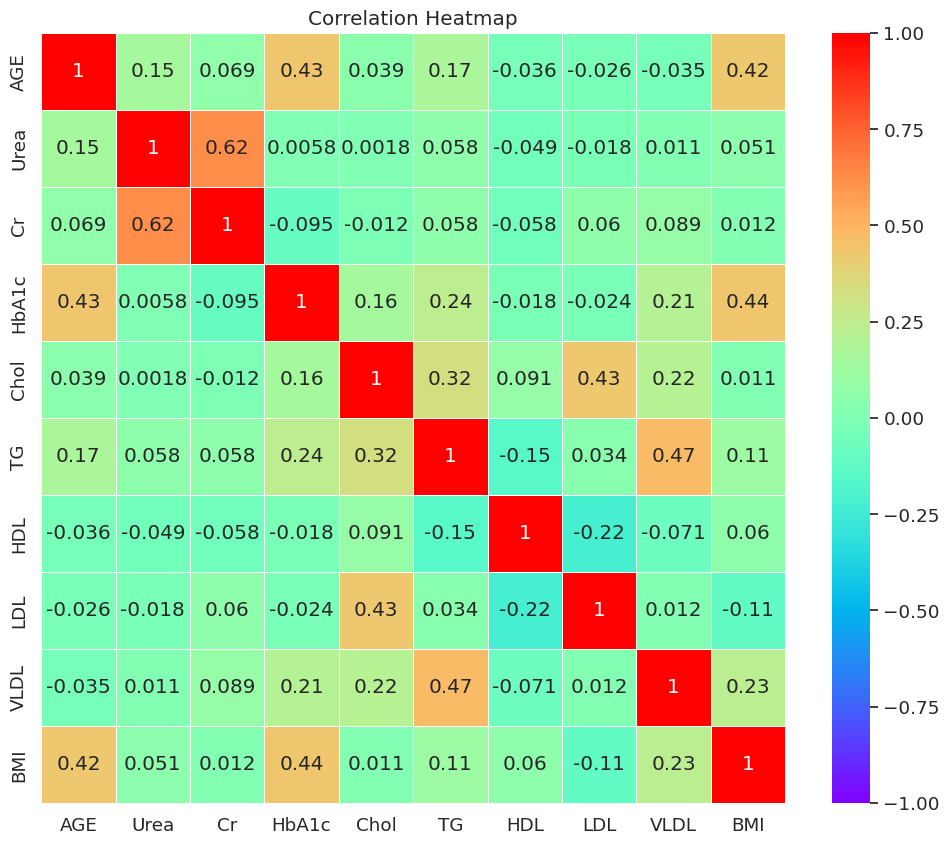

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import OneHotEncoder


df_encoded = pd.get_dummies(df, columns=['Gender'])


numeric_df = df_encoded.select_dtypes(include=[np.number])

# Compute correlation matrix
corr_matrix = numeric_df.corr()

# Plot correlation heatmap
plt.figure(figsize=(12, 10))
cmap = sns.color_palette("rainbow", as_cmap=True)
sns.heatmap(corr_matrix, annot=True, cmap=cmap, vmin=-1, vmax=1, center=0, linewidths=.5)
plt.title('Correlation Heatmap')
plt.show()


Feature engineering: HBA1C,BMI AND AGE IS GIVEN IMPORTANCE
Dividing the data set to training and testing
Training the model

In [ ]:
import pandas as pd
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.model_selection import train_test_split



columns_to_drop = ['Cr', 'HDL', 'LDL']
df_filtered = df.drop(columns=columns_to_drop)

# Display the filtered DataFrame
print(df_filtered)

features = ["Gender", "AGE", "Urea", "HbA1c", "Chol", "TG", "VLDL", "BMI"]
label_encoder = LabelEncoder()

# Encode categorical variables (assuming 'Gender' is categorical)
df['Gender'] = label_encoder.fit_transform(df['Gender'])
df['CLASS'] = label_encoder.fit_transform(df['CLASS'])

X = df[features]
y = df["CLASS"]

scaler = StandardScaler()
X = scaler.fit_transform(X)

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


    Gender       AGE      Urea     HbA1c      Chol        TG      VLDL  \
0        F -0.401144 -0.144781 -1.334983 -0.509436 -1.035084 -0.369958   
1        M -1.651878 -0.212954 -1.334983 -0.893730 -0.678063 -0.342649   
2        F -0.401144 -0.144781 -1.334983 -0.509436 -1.035084 -0.369958   
3        F -0.401144 -0.144781 -1.334983 -0.509436 -1.035084 -0.369958   
4        M -1.651878  0.673299 -1.334983  0.028576 -0.963680 -0.397267   
..     ...       ...       ...       ...       ...       ...       ...   
995      M  1.418104  1.218686 -0.505840  1.719471 -0.463850 -0.342649   
996      M -1.651878 -0.724254  1.586758 -0.586295 -0.106828  0.230845   
997      M -1.651878  0.673299 -0.624289 -0.586295 -0.892276  0.230845   
998      M -1.651878  0.230173 -0.624289  0.336011 -0.249637  0.230845   
999      M  0.053668 -0.042521 -0.545323 -0.816871 -0.463850 -0.315340   

          BMI CLASS  
0   -1.124622     N  
1   -1.326239     N  
2   -1.124622     N  
3   -1.124622     N  
4

In [ ]:
pip install -U imbalanced-learn


Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python3 -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


SMOTE

In [ ]:
from imblearn.over_sampling import SMOTE


In [ ]:
smote = SMOTE(sampling_strategy='auto', k_neighbors=3, random_state=42)


In [ ]:
from imblearn.over_sampling import RandomOverSampler

ros = RandomOverSampler(sampling_strategy='auto', random_state=42)
X_resampled, y_resampled = ros.fit_resample(X_train, y_train)


model performance and cross validation scores :

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, classification_report
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from xgboost import XGBClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.pipeline import make_pipeline
from sklearn.impute import SimpleImputer


df = df.dropna(subset=['CLASS'])

X = df.drop('CLASS', axis=1)
y = df['CLASS']


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


classifiers = [
    LogisticRegression(max_iter=1000, random_state=42),
    SVC(random_state=42),
    KNeighborsClassifier(),
    RandomForestClassifier(random_state=42),
    DecisionTreeClassifier(random_state=42),
    XGBClassifier(random_state=42),
    GradientBoostingClassifier(random_state=42),
    GaussianNB(),
    MLPClassifier(max_iter=1000, random_state=42),
    AdaBoostClassifier(random_state=42),
    BaggingClassifier(random_state=42),
    ExtraTreesClassifier(random_state=42)
]


pipeline = make_pipeline(SimpleImputer(strategy='mean'), StandardScaler())


for classifier in classifiers:

    clf = classifier


    if isinstance(classifier, (MLPClassifier)):
        clf = make_pipeline(pipeline, classifier)


    clf.fit(X_train, y_train)


    y_pred = clf.predict(X_test)


    accuracy = accuracy_score(y_test, y_pred)
    classification_rep = classification_report(y_test, y_pred, zero_division=1)

    print(f"\nClassifier: {type(classifier).__name__}")
    print(f"Accuracy: {accuracy:.2%}")
    print("Classification Report:")
    print(classification_rep)


    try:
        cross_val_scores = cross_val_score(clf, X, y, cv=5, scoring='accuracy')
        print(f"Cross-Validation Accuracy: {cross_val_scores.mean():.2%}")
    except Exception as e:
        print(f"Cross-Validation Error: {str(e)}")



Classifier: LogisticRegression
Accuracy: 95.00%
Classification Report:
              precision    recall  f1-score   support

           0       0.86      0.86      0.86        21
           1       0.40      0.33      0.36         6
           2       0.98      0.98      0.98       173

    accuracy                           0.95       200
   macro avg       0.74      0.72      0.73       200
weighted avg       0.95      0.95      0.95       200

Cross-Validation Accuracy: 91.00%

Classifier: SVC
Accuracy: 96.00%
Classification Report:
              precision    recall  f1-score   support

           0       0.83      0.90      0.86        21
           1       0.75      0.50      0.60         6
           2       0.98      0.98      0.98       173

    accuracy                           0.96       200
   macro avg       0.85      0.80      0.82       200
weighted avg       0.96      0.96      0.96       200

Cross-Validation Accuracy: 90.70%

Classifier: KNeighborsClassifier
Accurac

Confusion matrix for all the above models:

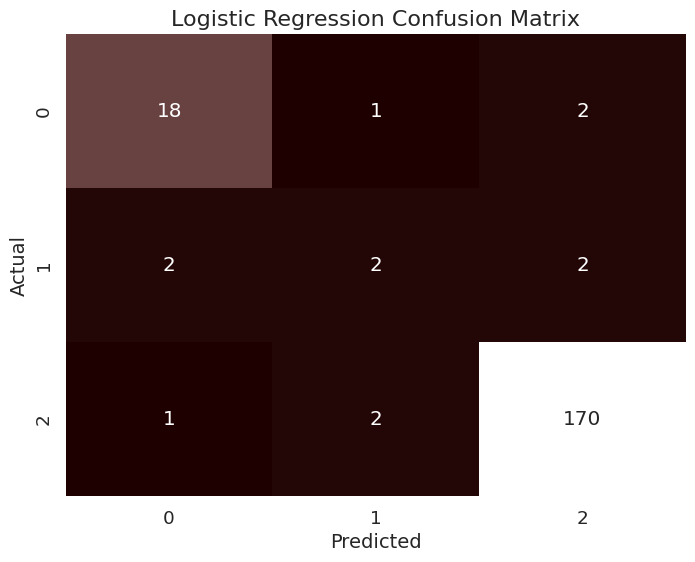

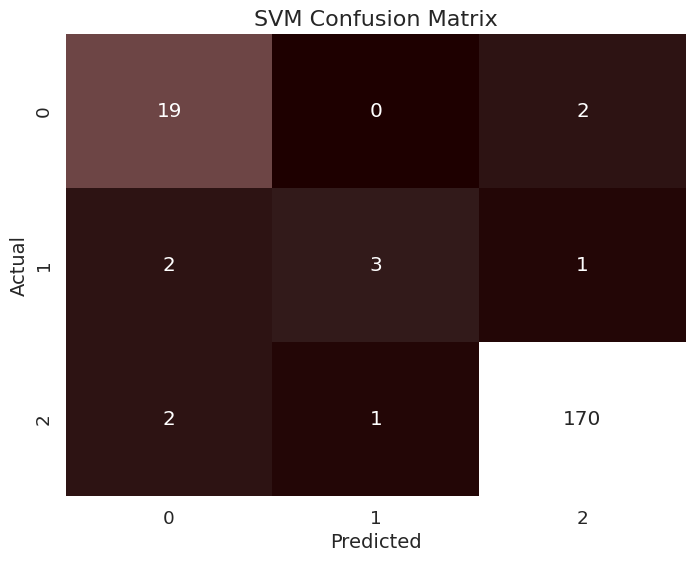

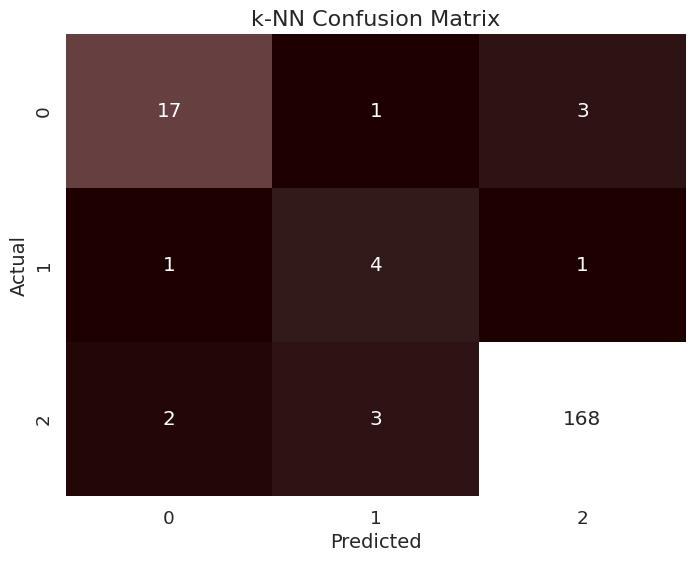

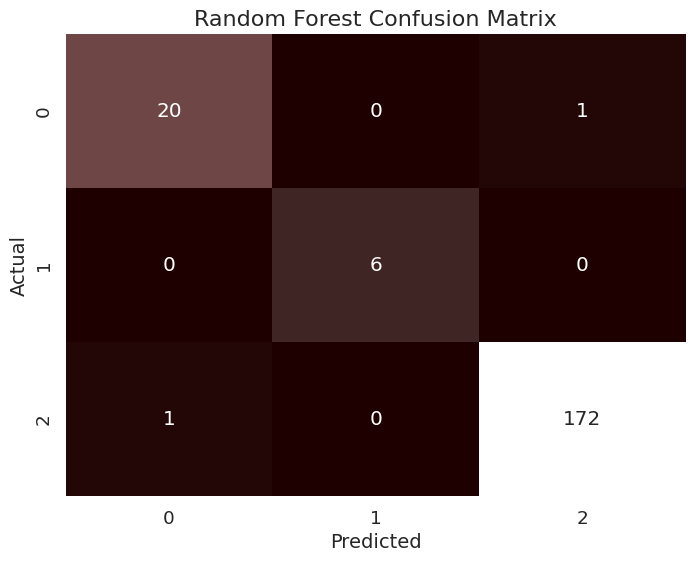

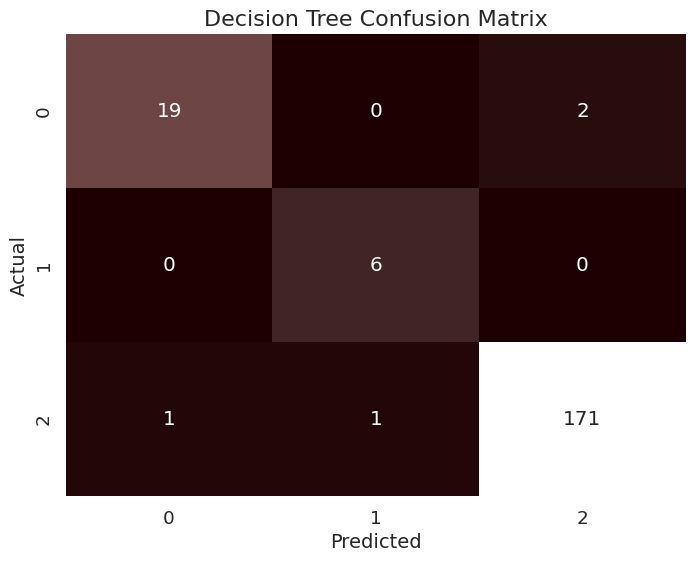

...

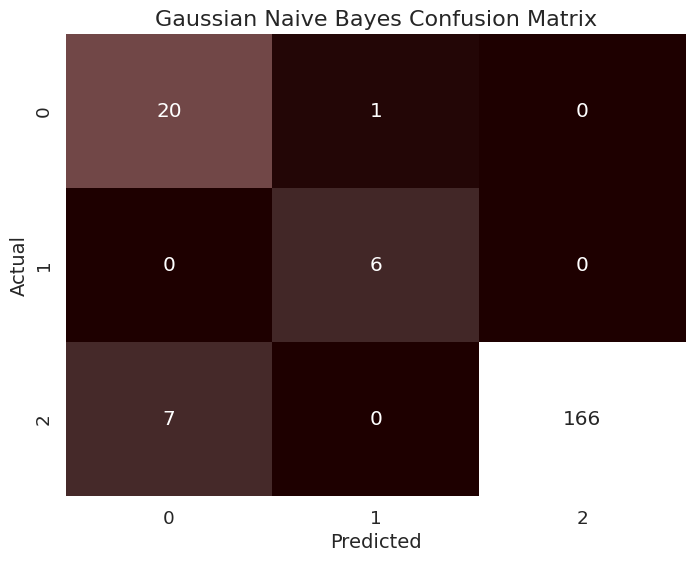

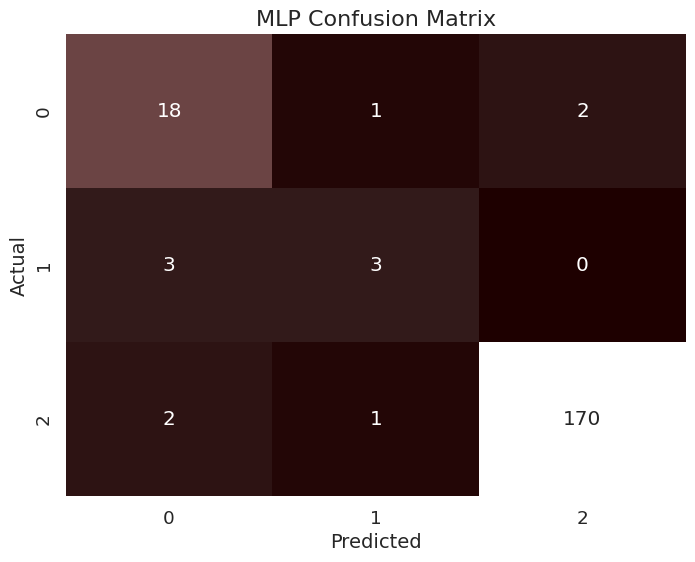

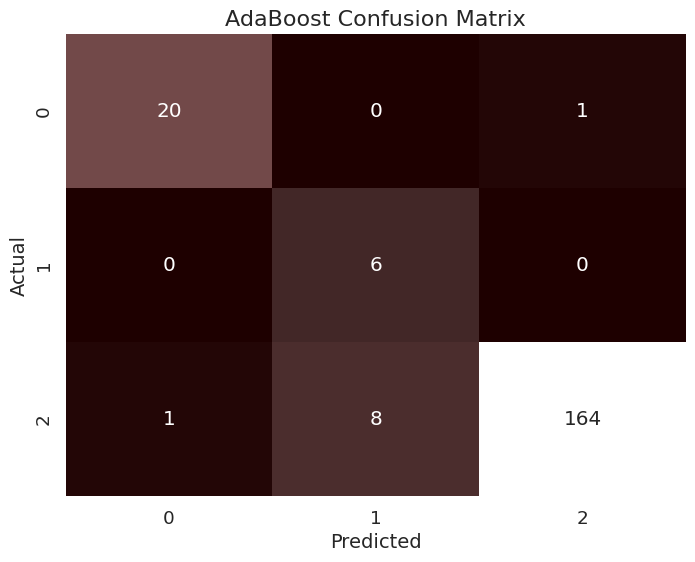

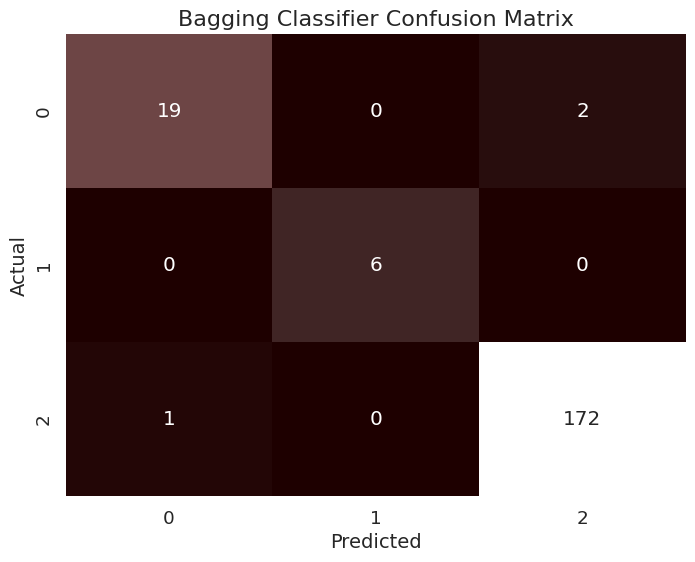

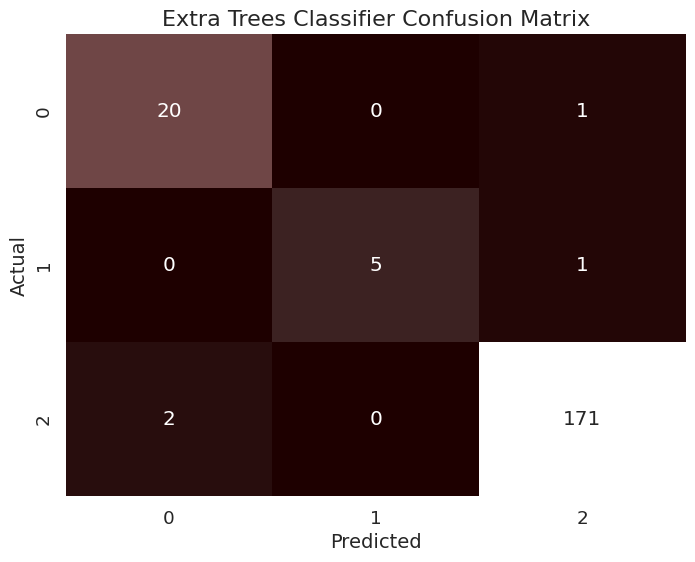

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier, BaggingClassifier, ExtraTreesClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np


X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

def evaluate_model(model, X_train, y_train, X_test, y_test, model_name, classes=[0, 1, 2]):
    model.fit(X_train, y_train)

    y_pred = model.predict(X_test)
    cm = confusion_matrix(y_test, y_pred, labels=classes)

    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='d', cmap='pink', cbar=False,
                xticklabels=classes, yticklabels=classes)

    plt.title(f'{model_name} Confusion Matrix', fontsize=16)
    plt.xlabel('Predicted', fontsize=14)
    plt.ylabel('Actual', fontsize=14)
    plt.show()

evaluate_model(LogisticRegression(), X_train, y_train, X_test, y_test, 'Logistic Regression')
evaluate_model(SVC(), X_train, y_train, X_test, y_test, 'SVM')
evaluate_model(KNeighborsClassifier(), X_train, y_train, X_test, y_test, 'k-NN')
evaluate_model(RandomForestClassifier(), X_train, y_train, X_test, y_test, 'Random Forest')
evaluate_model(DecisionTreeClassifier(), X_train, y_train, X_test, y_test, 'Decision Tree')
evaluate_model(XGBClassifier(), X_train, y_train, X_test, y_test, 'XGBoost')
evaluate_model(GradientBoostingClassifier(), X_train, y_train, X_test, y_test, 'Gradient Boosting')
evaluate_model(GaussianNB(), X_train, y_train, X_test, y_test, 'Gaussian Naive Bayes')
evaluate_model(MLPClassifier(), X_train, y_train, X_test, y_test, 'MLP')
evaluate_model(AdaBoostClassifier(), X_train, y_train, X_test, y_test, 'AdaBoost')
evaluate_model(BaggingClassifier(), X_train, y_train, X_test, y_test, 'Bagging Classifier')
evaluate_model(ExtraTreesClassifier(), X_train, y_train, X_test, y_test, 'Extra Trees Classifier')


In [ ]:
pip install --upgrade scikit-learn


Defaulting to user installation because normal site-packages is not writeable

[notice] A new release of pip is available: 23.2.1 -> 23.3.1
[notice] To update, run: python3 -m pip install --upgrade pip
Note: you may need to restart the kernel to use updated packages.


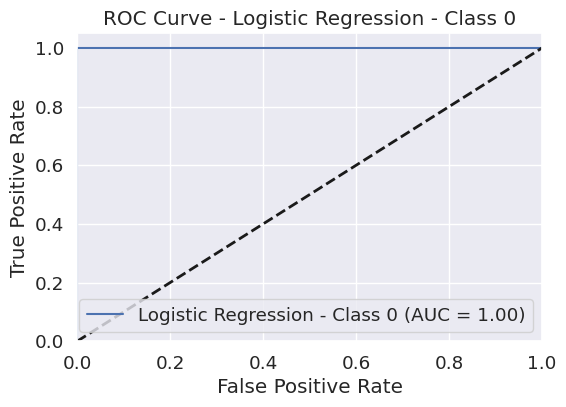

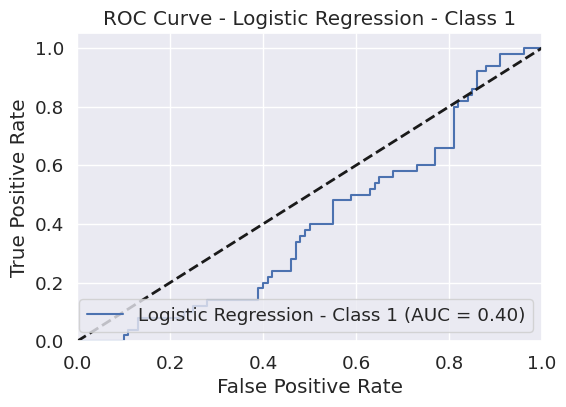

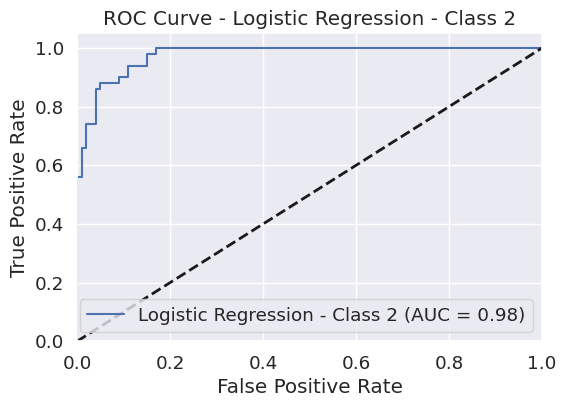

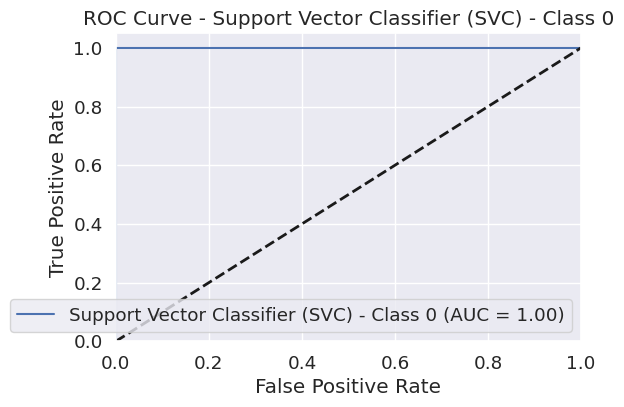

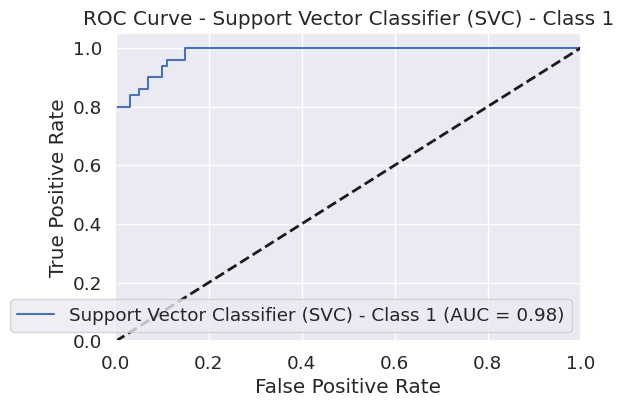

...

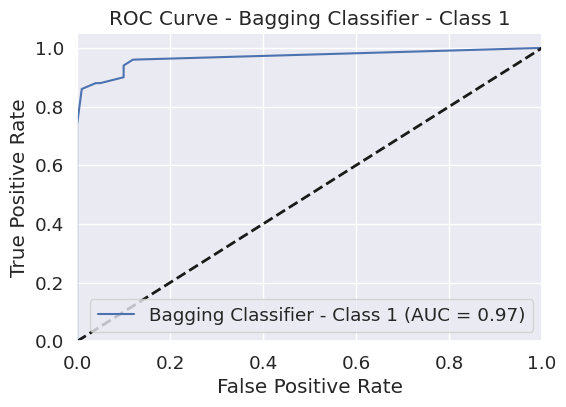

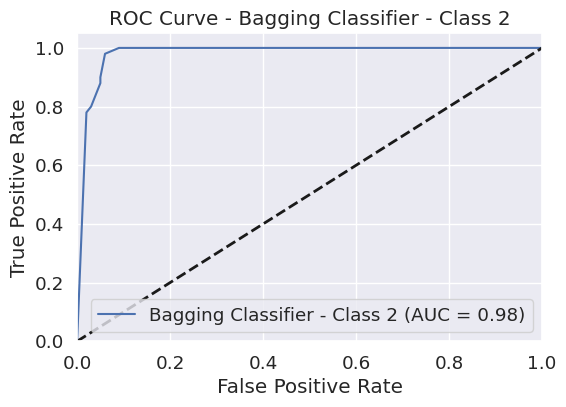

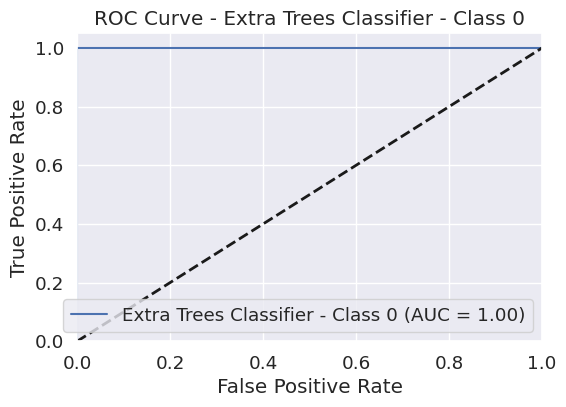

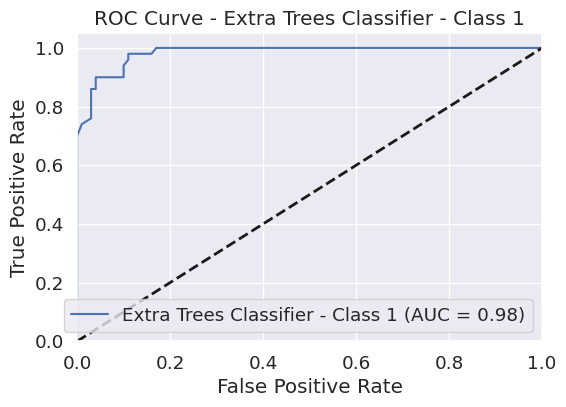

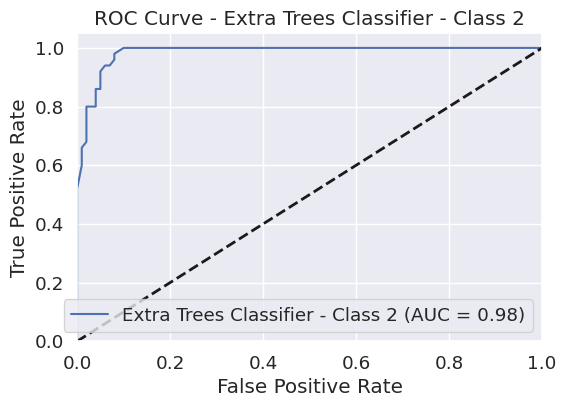

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from sklearn import datasets
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier, BaggingClassifier, ExtraTreesClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier
from imblearn.over_sampling import SMOTE


iris = datasets.load_iris()
X = iris.data
y = iris.target

# Binarize the output
y_bin = label_binarize(y, classes=[0, 1, 2])

models_with_cross_val = [
    ('Logistic Regression', LogisticRegression()),
    ('Support Vector Classifier (SVC)', SVC(probability=True)),
    ('K Neighbors Classifier', KNeighborsClassifier()),
    ('Random Forest Classifier', RandomForestClassifier()),
    ('Decision Tree Classifier', DecisionTreeClassifier()),
    ('Gradient Boosting Classifier', GradientBoostingClassifier()),
    ('MLP Classifier', MLPClassifier()),
    ('AdaBoost Classifier', AdaBoostClassifier()),
    ('Bagging Classifier', BaggingClassifier()),
    ('Extra Trees Classifier', ExtraTreesClassifier())
]

# Function to calculate and plot ROC curve for each model
def plot_roc_curve(model, X, y):
    # Use OneVsRestClassifier for multi-class classification
    classifier = OneVsRestClassifier(model[1])

    # Perform cross-validation
    y_scores = cross_val_predict(classifier, X, y_bin, cv=5, method='predict_proba')

    # Compute ROC curve and ROC area for each class
    fpr = dict()
    tpr = dict()
    roc_auc = dict()

    for i in range(y_bin.shape[1]):
        fpr[i], tpr[i], _ = roc_curve(y_bin[:, i], y_scores[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

        # Plot ROC curve
        plt.figure(figsize=(6, 4))
        plt.plot(fpr[i], tpr[i], label=f'{model[0]} - Class {i} (AUC = {roc_auc[i]:.2f})')
        plt.plot([0, 1], [0, 1], 'k--', linewidth=2)
        plt.xlim([0.0, 1.0])
        plt.ylim([0.0, 1.05])
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title(f'ROC Curve - {model[0]} - Class {i}')
        plt.legend(loc="lower right")
        plt.show()

# Plot ROC curves for each model
for model in models_with_cross_val:
    plot_roc_curve(model, X, y)


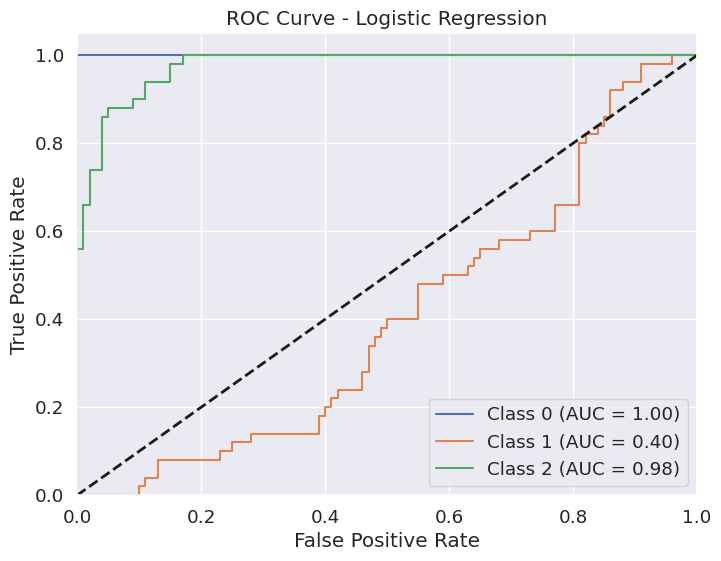

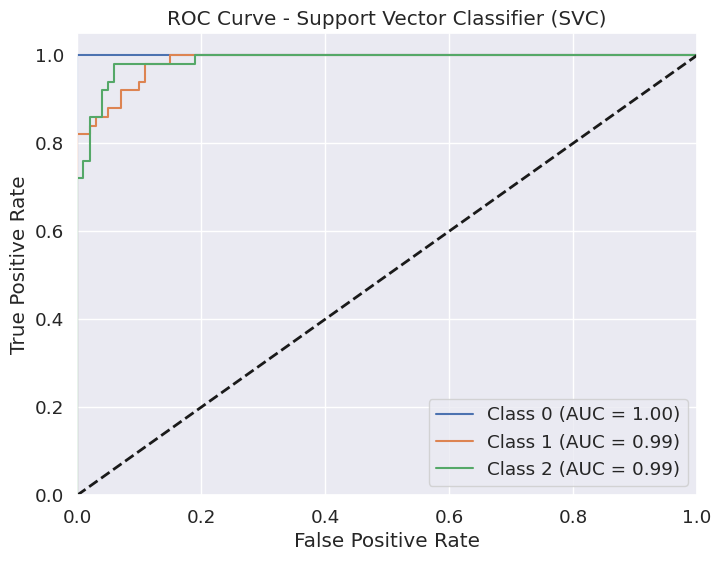

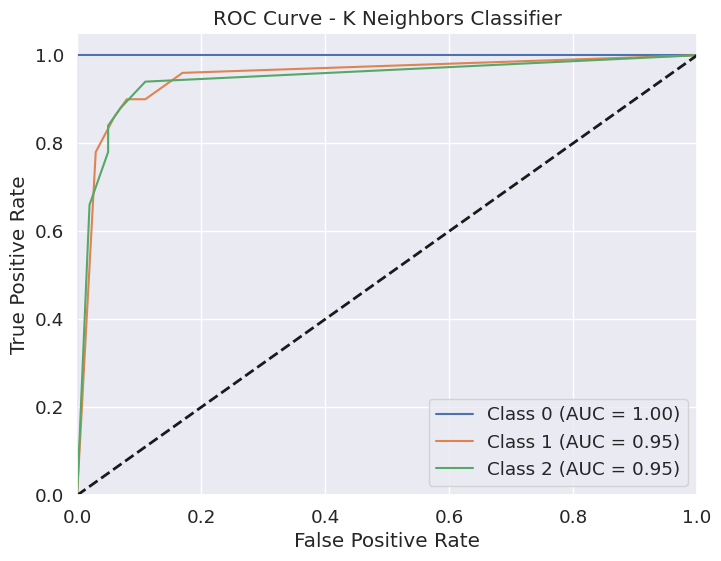

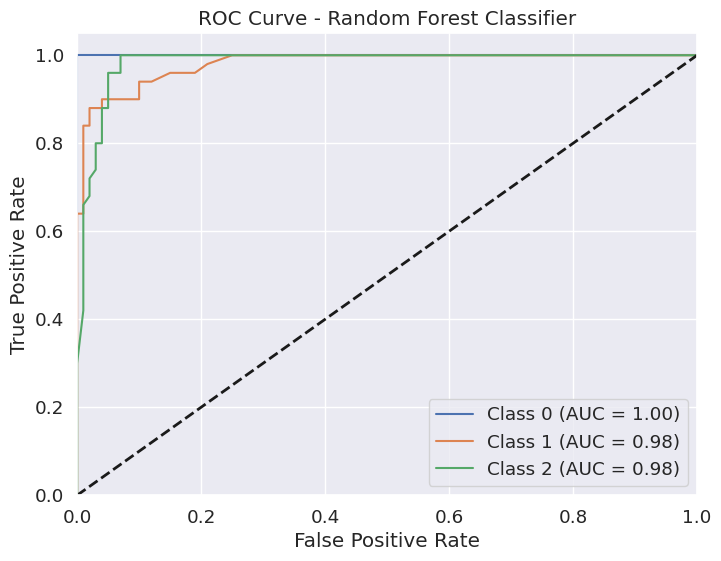

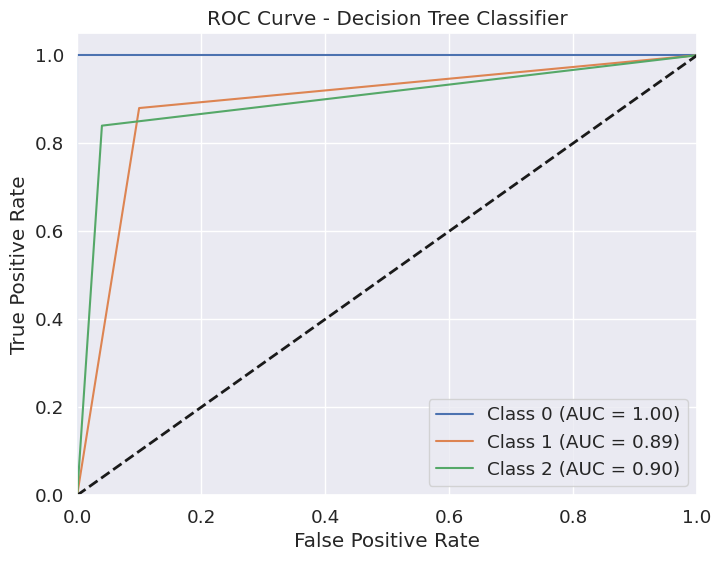

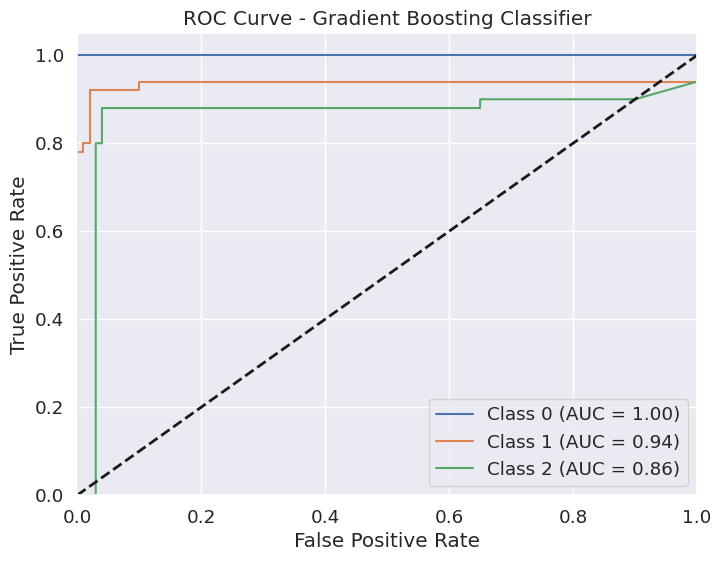

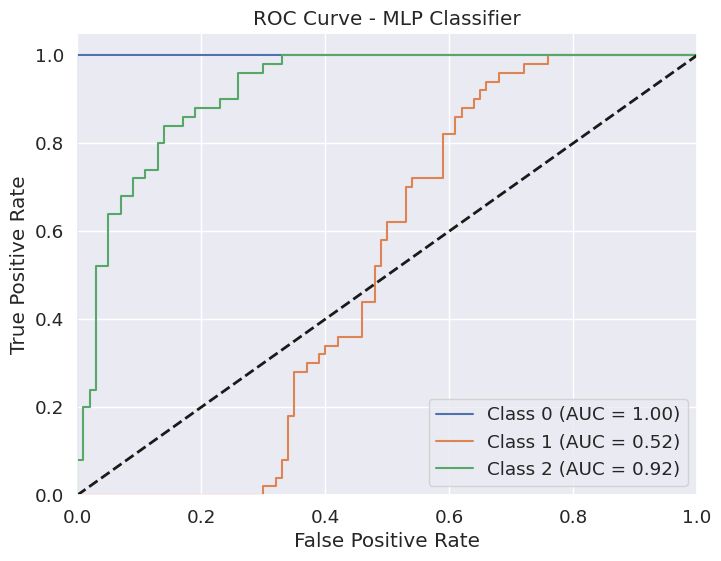

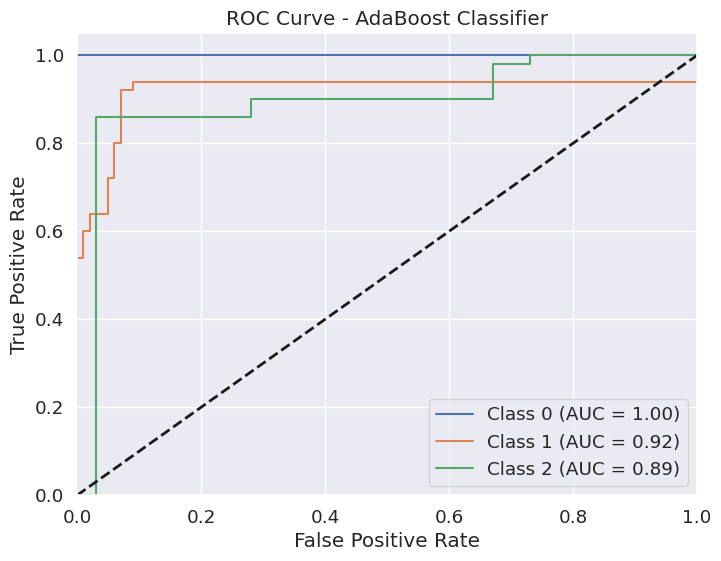

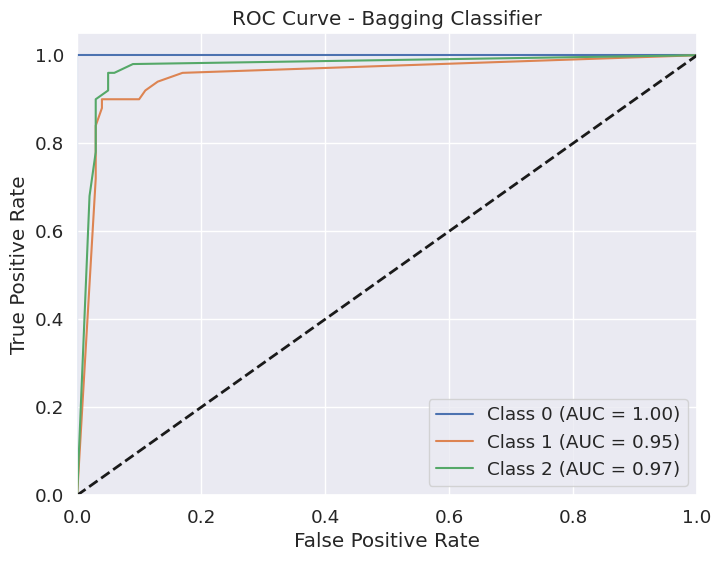

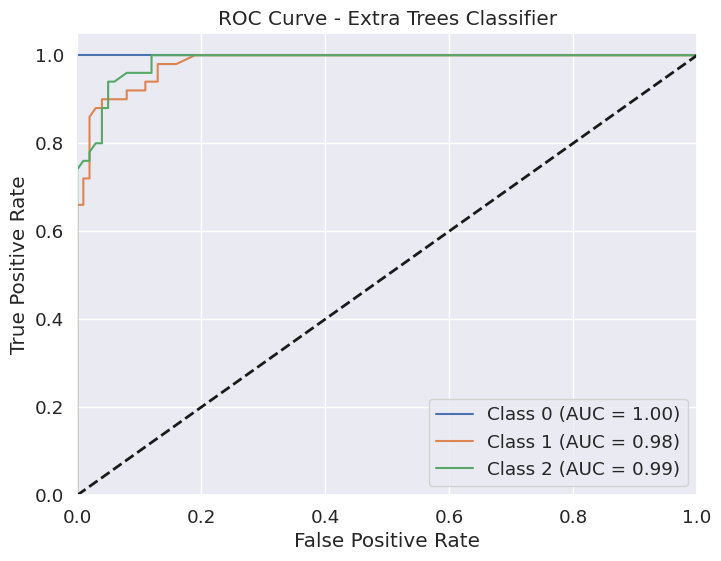

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import roc_curve, auc
from sklearn.preprocessing import label_binarize
from sklearn.multiclass import OneVsRestClassifier
from sklearn import datasets


iris = datasets.load_iris()
X = iris.data
y = iris.target

# Binarize the output
y_bin = label_binarize(y, classes=[0, 1, 2])

# Function to calculate and plot ROC curve for each model
def plot_roc_curve(model, X, y):
    # Use OneVsRestClassifier for multi-class classification
    classifier = OneVsRestClassifier(model[1])

    # Perform cross-validation
    y_scores = cross_val_predict(classifier, X, y_bin, cv=5, method='predict_proba')

    # Compute ROC curve and ROC area for each class
    fpr = dict()
    tpr = dict()
    roc_auc = dict()

    for i in range(y_bin.shape[1]):
        fpr[i], tpr[i], _ = roc_curve(y_bin[:, i], y_scores[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    # Plot ROC curve
    plt.figure(figsize=(8, 6))
    for i in range(y_bin.shape[1]):
        plt.plot(fpr[i], tpr[i], label=f'Class {i} (AUC = {roc_auc[i]:.2f})')

    plt.plot([0, 1], [0, 1], 'k--', linewidth=2)
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title(f'ROC Curve - {model[0]}')
    plt.legend(loc="lower right")
    plt.show()

# Plot ROC curve for each model
for model in models_with_cross_val:
    plot_roc_curve(model, X, y)


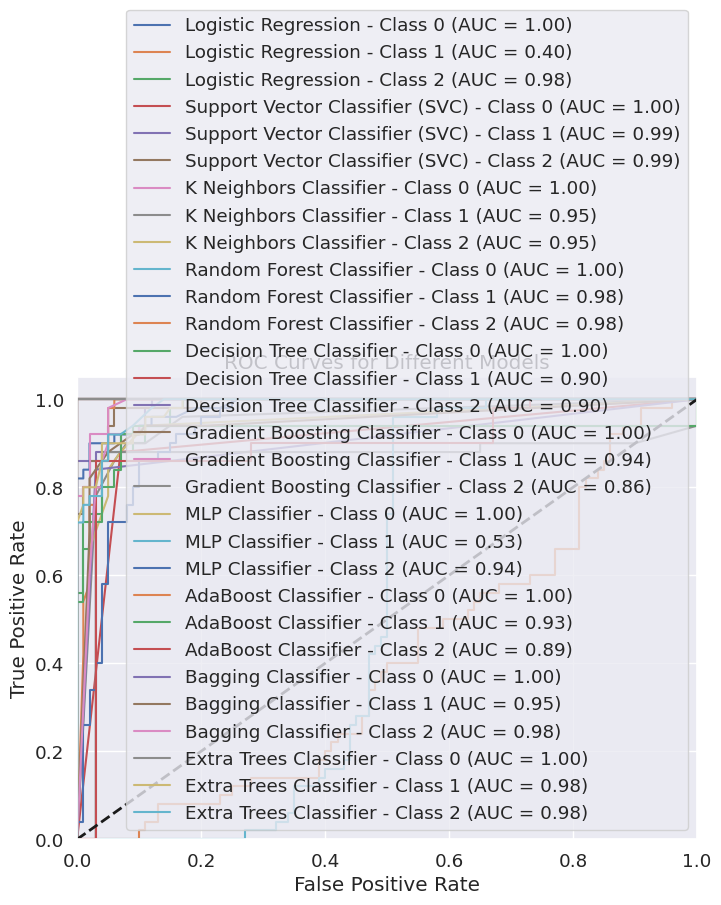

In [ ]:


# Binarize the output
y_bin = label_binarize(y, classes=np.unique(y))

# List of models
models_with_cross_val = [
    ('Logistic Regression', LogisticRegression()),
    ('Support Vector Classifier (SVC)', SVC(probability=True)),
    ('K Neighbors Classifier', KNeighborsClassifier()),
    ('Random Forest Classifier', RandomForestClassifier()),
    ('Decision Tree Classifier', DecisionTreeClassifier()),
    ('Gradient Boosting Classifier', GradientBoostingClassifier()),
    ('MLP Classifier', MLPClassifier()),
    ('AdaBoost Classifier', AdaBoostClassifier()),
    ('Bagging Classifier', BaggingClassifier()),
    ('Extra Trees Classifier', ExtraTreesClassifier())
]

# Function to calculate and plot ROC curve for each model
def plot_roc_curve(models, X, y):
    plt.figure(figsize=(8, 6))

    for model in models:
        # Use OneVsRestClassifier for multi-class classification
        classifier = OneVsRestClassifier(model[1])

        # Perform cross-validation
        y_scores = cross_val_predict(classifier, X, y_bin, cv=5, method='predict_proba')

        # Compute ROC curve and ROC area for each class
        fpr = dict()
        tpr = dict()
        roc_auc = dict()

        for i in range(y_bin.shape[1]):
            fpr[i], tpr[i], _ = roc_curve(y_bin[:, i], y_scores[:, i])
            roc_auc[i] = auc(fpr[i], tpr[i])

        # Plot ROC curve
        for i in range(y_bin.shape[1]):
            plt.plot(fpr[i], tpr[i], label=f'{model[0]} - Class {i} (AUC = {roc_auc[i]:.2f})')

    plt.plot([0, 1], [0, 1], 'k--', linewidth=2)
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curves for Different Models')
    plt.legend(loc="lower right")
    plt.show()

# Plot ROC curves for all models
plot_roc_curve(models_with_cross_val, X, y)


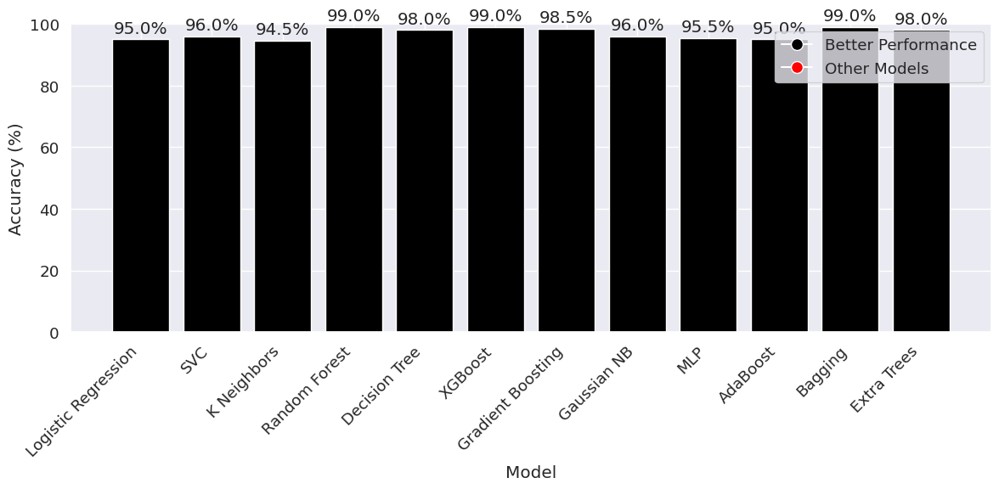

In [ ]:
import matplotlib.pyplot as plt

model_names = [
    'Logistic Regression',
    'SVC',
    'K Neighbors',
    'Random Forest',
    'Decision Tree',
    'XGBoost',
    'Gradient Boosting',
    'Gaussian NB',
    'MLP',
    'AdaBoost',
    'Bagging',
    'Extra Trees'
]

accuracy_values = [95.00, 96.00, 94.50, 99.00, 98.00, 99.00, 98.50, 96.00, 95.50, 95.00, 99.00, 98.00]


colors = ['black' if acc > 90 else 'red' for acc in accuracy_values]


plt.figure(figsize=(12, 6))
bars = plt.bar(model_names, accuracy_values, color=colors)
plt.xlabel('Model')
plt.ylabel('Accuracy (%)')
plt.ylim(0, 100)
plt.xticks(rotation=45, ha='right')


black_patch = plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='black', markersize=10, label='Better Performance')
red_patch = plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='red', markersize=10, label='Other Models')
plt.legend(handles=[black_patch, red_patch])


for bar, acc in zip(bars, accuracy_values):
    plt.text(bar.get_x() + bar.get_width() / 2, bar.get_height() + 1, f'{acc}%', ha='center', va='bottom')

plt.tight_layout()
plt.show()



Performance Metrics for Logistic Regression:
  Confusion Matrix:
[[50  0  0]
 [ 0 47  3]
 [ 0  1 49]]
  Accuracy: 97.3%
  Cross-Validation Accuracy: 97.3%


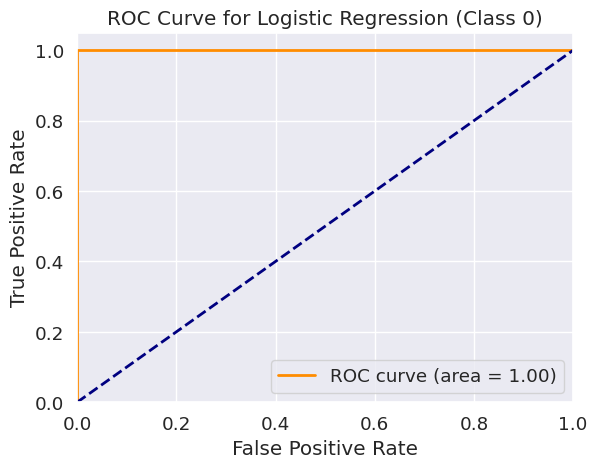

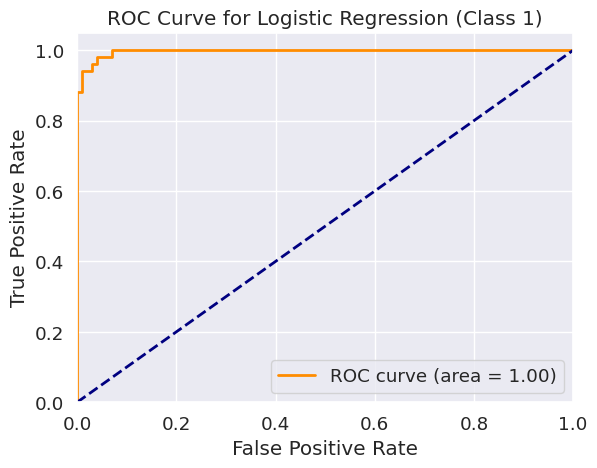

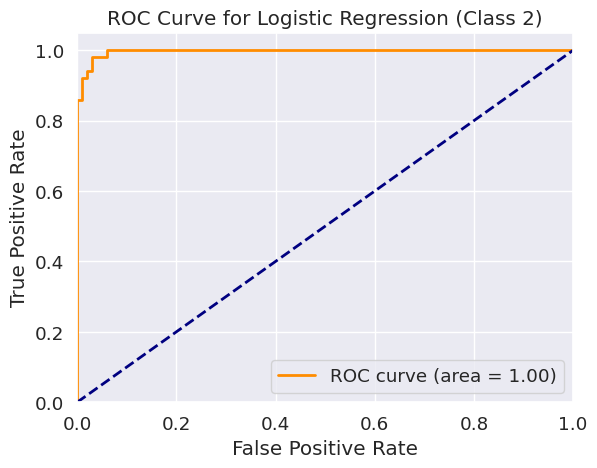


Performance Metrics for Support Vector Classifier (SVC):
  Confusion Matrix:
[[50  0  0]
 [ 0 48  2]
 [ 0  2 48]]
  Accuracy: 97.3%
  Cross-Validation Accuracy: 96.7%


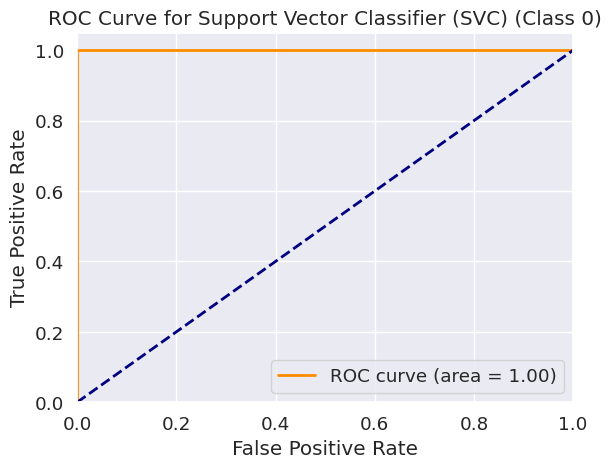

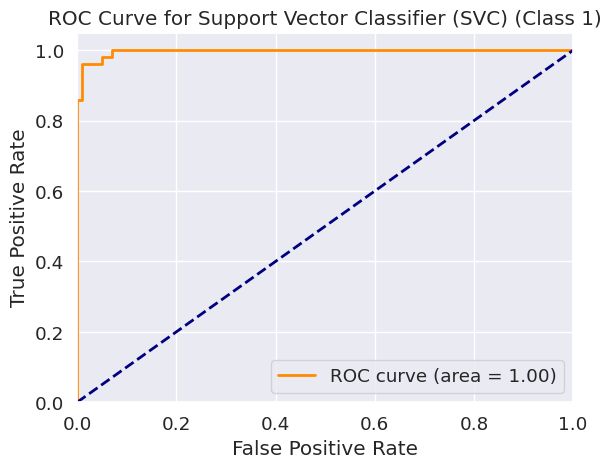

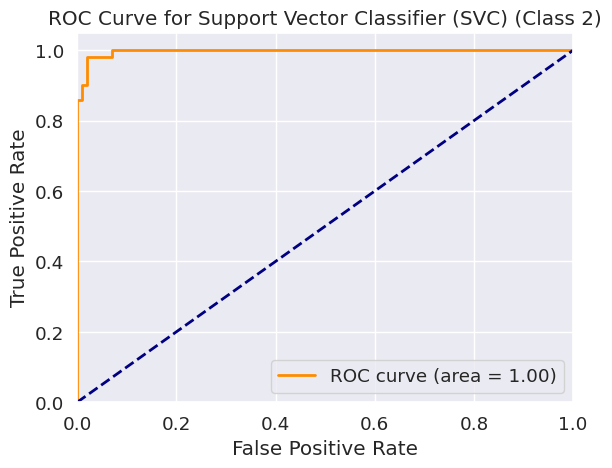


Performance Metrics for K Neighbors Classifier:
  Confusion Matrix:
[[50  0  0]
 [ 0 47  3]
 [ 0  2 48]]
  Accuracy: 96.7%
  Cross-Validation Accuracy: 97.3%


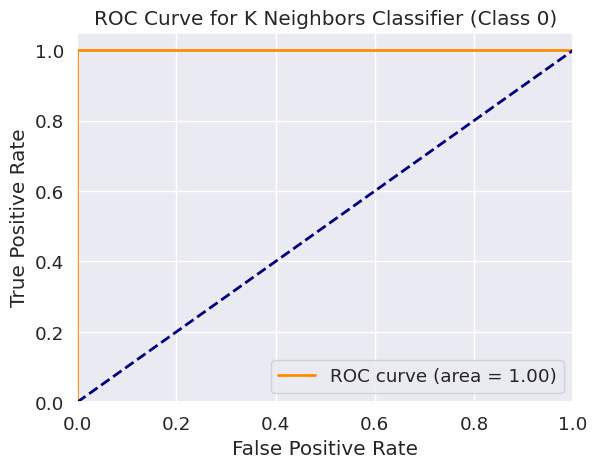

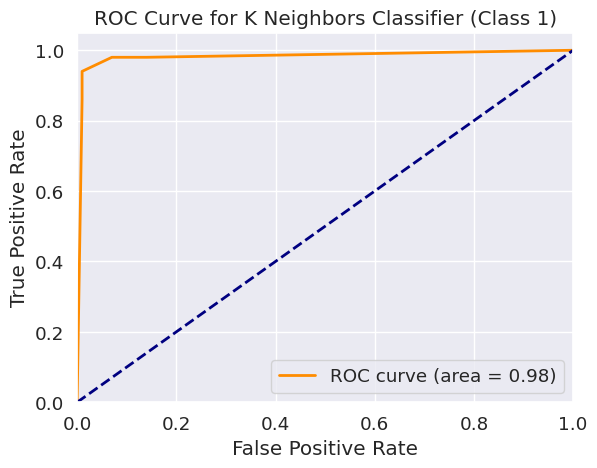

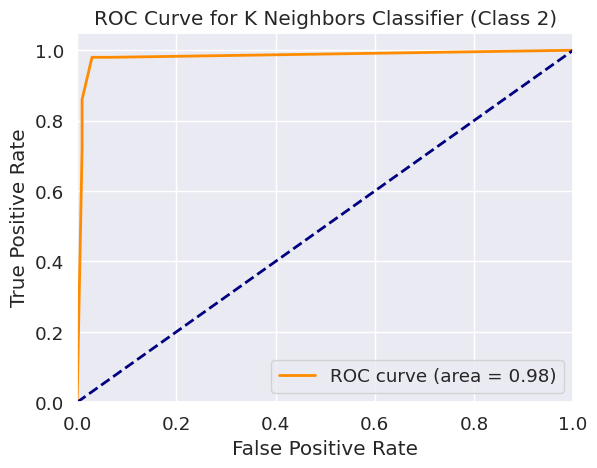


Performance Metrics for Random Forest Classifier:
  Confusion Matrix:
[[50  0  0]
 [ 0 50  0]
 [ 0  0 50]]
  Accuracy: 100.0%
  Cross-Validation Accuracy: 96.0%


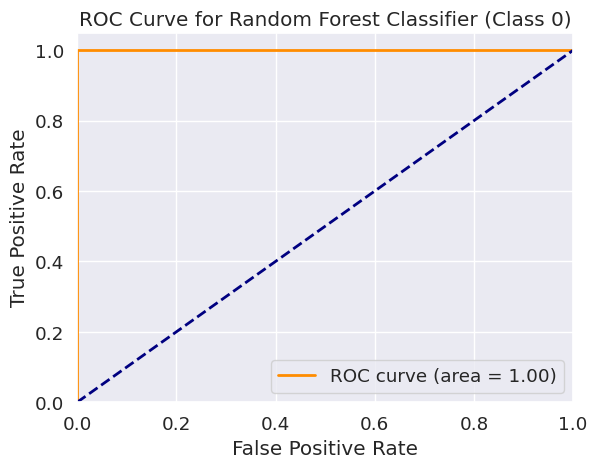

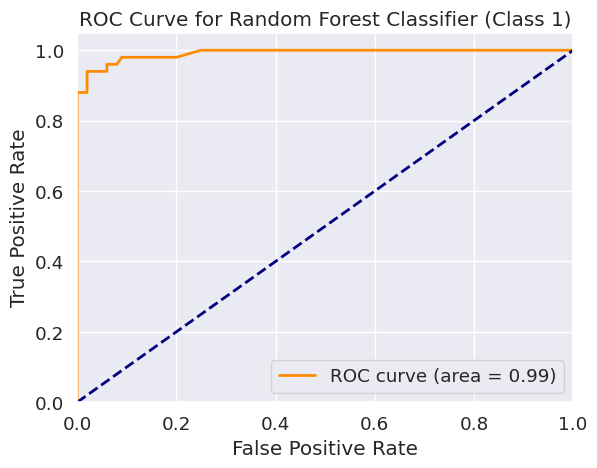

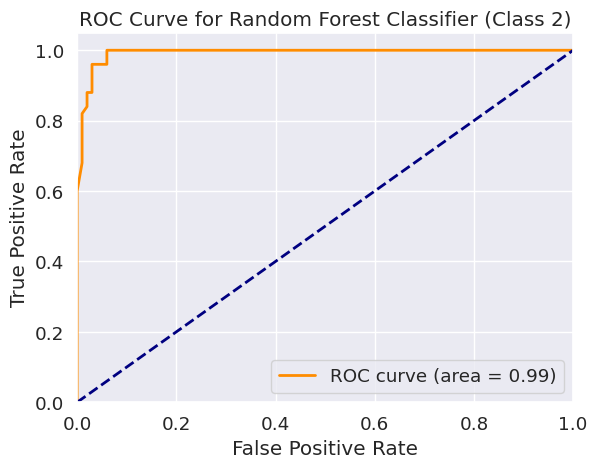


Performance Metrics for Decision Tree Classifier:
  Confusion Matrix:
[[50  0  0]
 [ 0 50  0]
 [ 0  0 50]]
  Accuracy: 100.0%
  Cross-Validation Accuracy: 95.3%


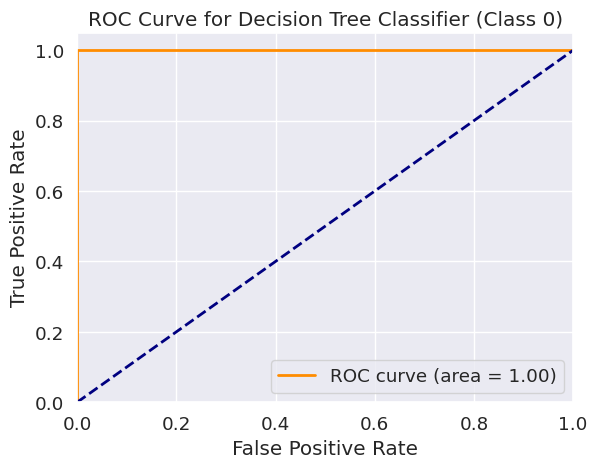

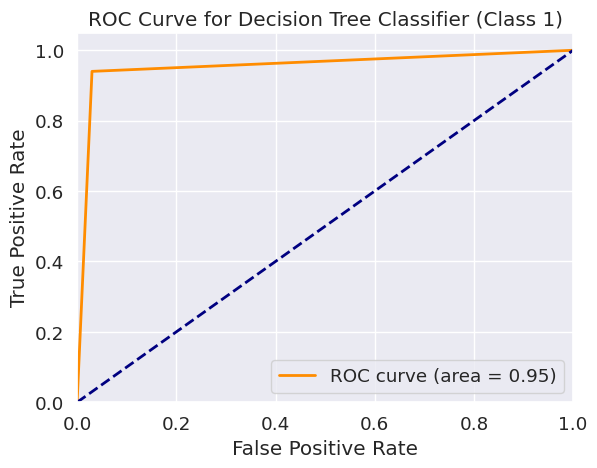

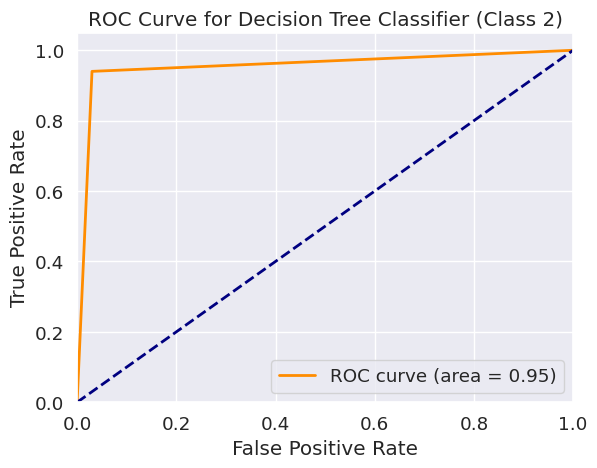


Performance Metrics for Gradient Boosting Classifier:
  Confusion Matrix:
[[50  0  0]
 [ 0 50  0]
 [ 0  0 50]]
  Accuracy: 100.0%
  Cross-Validation Accuracy: 96.0%


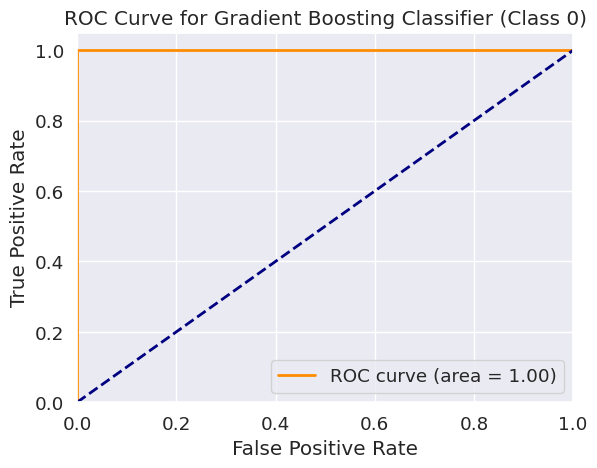

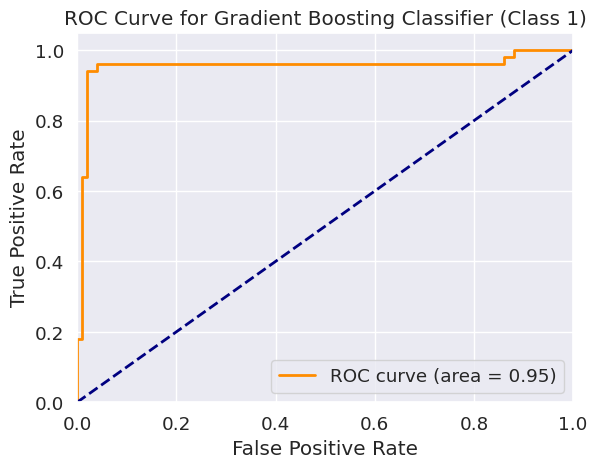

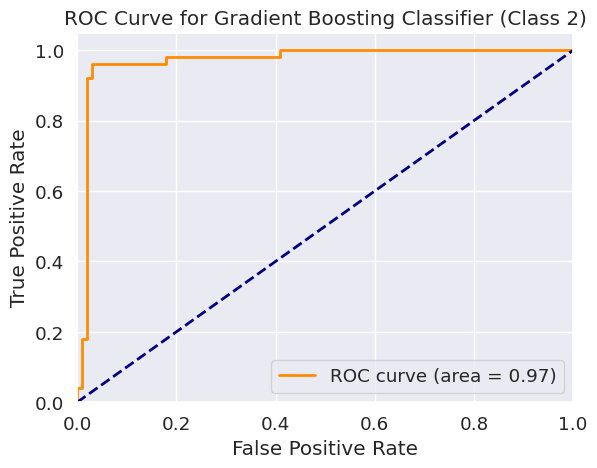


Performance Metrics for MLP Classifier:
  Confusion Matrix:
[[50  0  0]
 [ 0 47  3]
 [ 0  0 50]]
  Accuracy: 98.0%
  Cross-Validation Accuracy: 97.3%


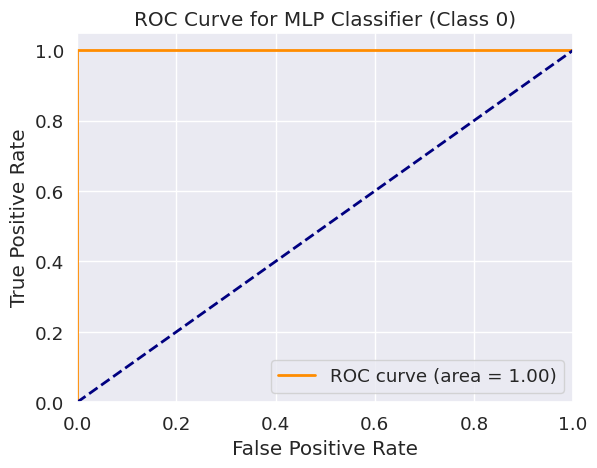

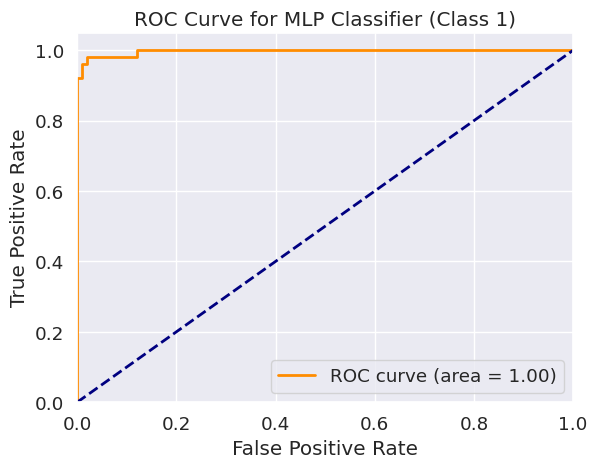

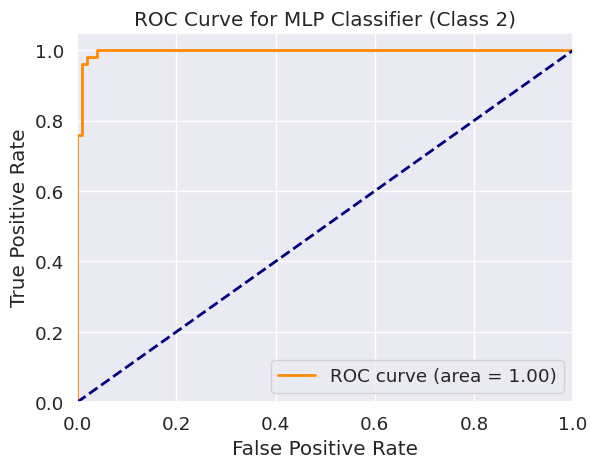


Performance Metrics for AdaBoost Classifier:
  Confusion Matrix:
[[50  0  0]
 [ 0 48  2]
 [ 0  4 46]]
  Accuracy: 96.0%
  Cross-Validation Accuracy: 94.7%


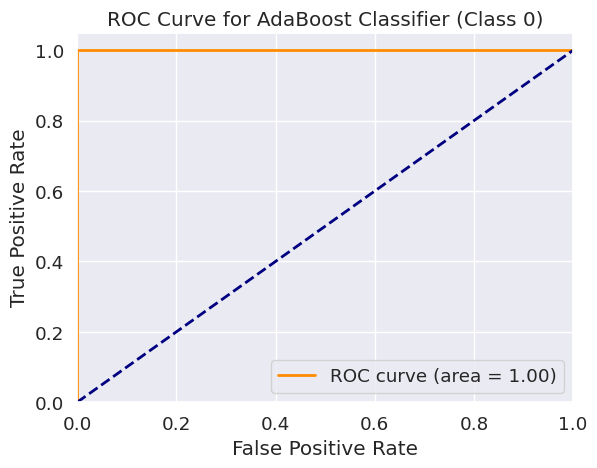

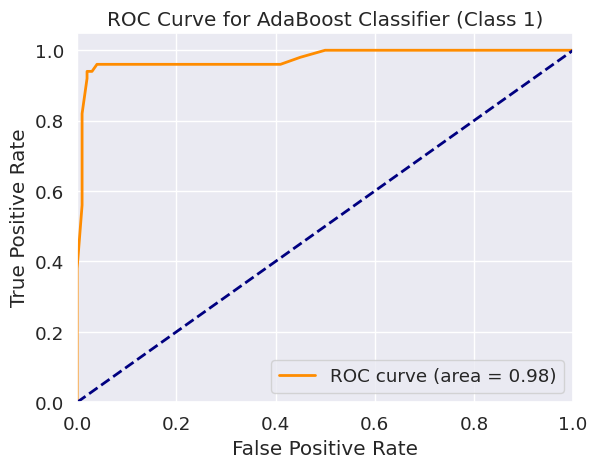

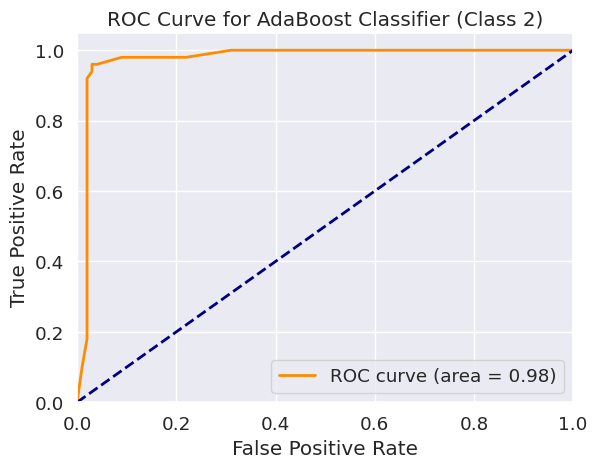


Performance Metrics for Bagging Classifier:
  Confusion Matrix:
[[50  0  0]
 [ 0 50  0]
 [ 0  1 49]]
  Accuracy: 99.3%
  Cross-Validation Accuracy: 96.0%


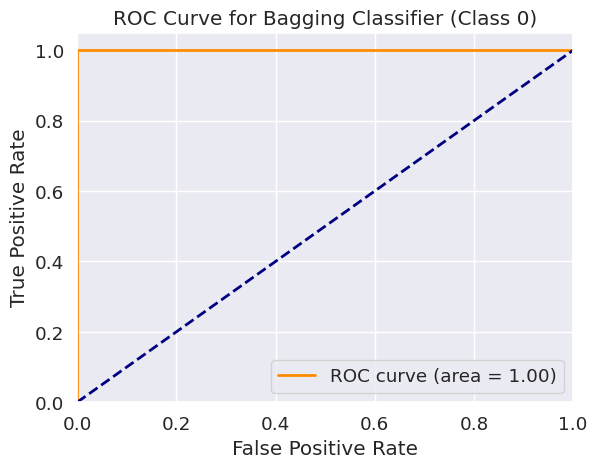

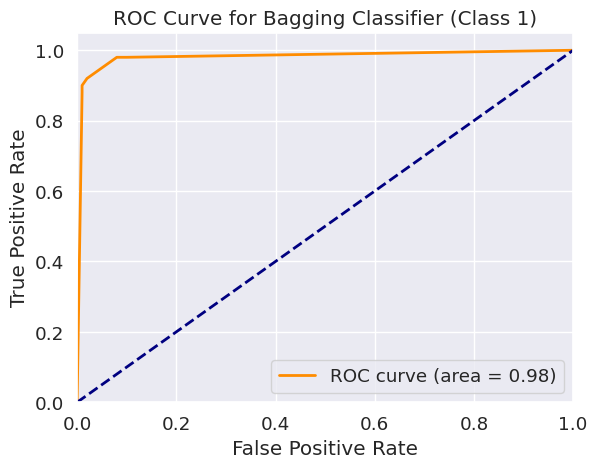

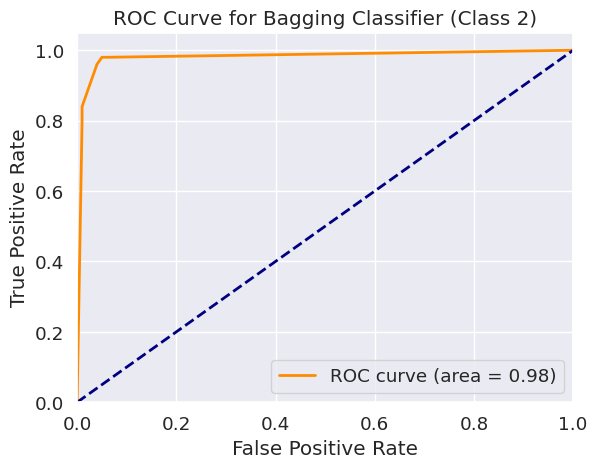


Performance Metrics for Extra Trees Classifier:
  Confusion Matrix:
[[50  0  0]
 [ 0 50  0]
 [ 0  0 50]]
  Accuracy: 100.0%
  Cross-Validation Accuracy: 95.3%


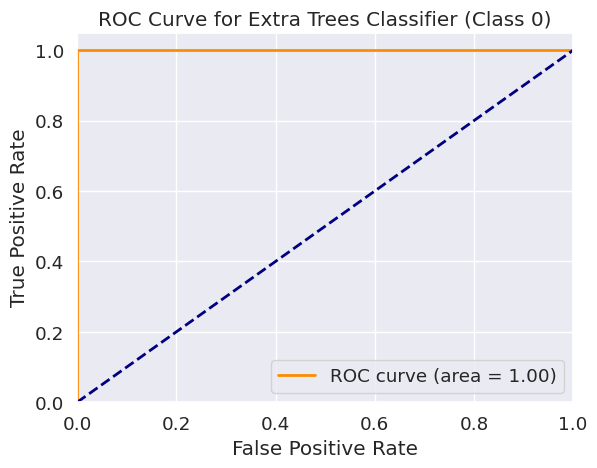

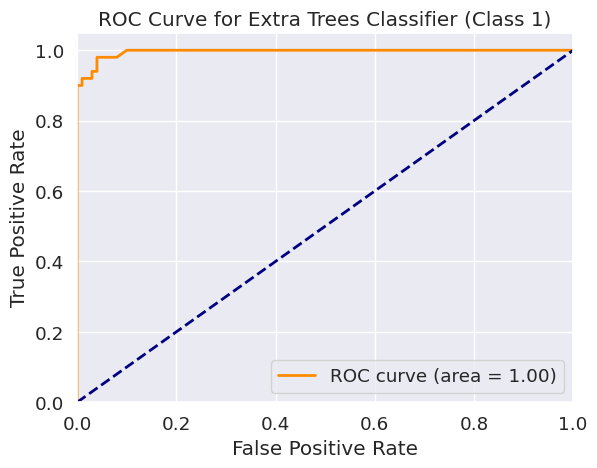

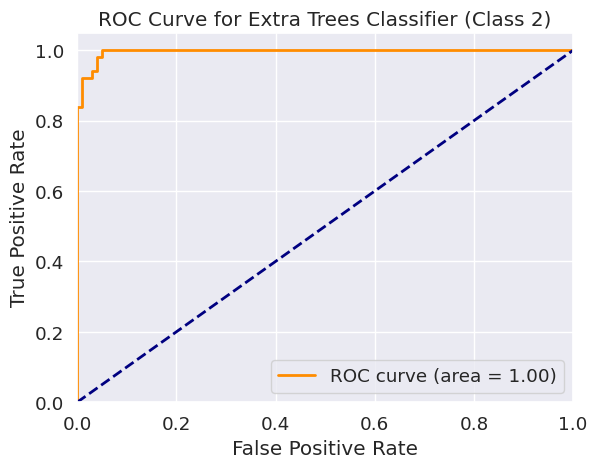

In [ ]:
from sklearn.metrics import roc_curve, auc
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier, BaggingClassifier, ExtraTreesClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier
from imblearn.over_sampling import SMOTE



models_with_cross_val = [
    ('Logistic Regression', LogisticRegression()),
    ('Support Vector Classifier (SVC)', SVC(probability=True)),
    ('K Neighbors Classifier', KNeighborsClassifier()),
    ('Random Forest Classifier', RandomForestClassifier()),
    ('Decision Tree Classifier', DecisionTreeClassifier()),
    ('Gradient Boosting Classifier', GradientBoostingClassifier()),
    ('MLP Classifier', MLPClassifier()),
    ('AdaBoost Classifier', AdaBoostClassifier()),
    ('Bagging Classifier', BaggingClassifier()),
    ('Extra Trees Classifier', ExtraTreesClassifier())
]


for name, classifier in models_with_cross_val:

    classifier.fit(X, y)


    y_probas = cross_val_predict(classifier, X, y, cv=5, method='predict_proba')


    y_pred = classifier.predict(X)
    conf_matrix = confusion_matrix(y, y_pred)
    print(f'\nPerformance Metrics for {name}:')
    print(f'  Confusion Matrix:\n{conf_matrix}')


    accuracy = np.sum(np.diag(conf_matrix)) / np.sum(conf_matrix)
    cross_val_accuracy = np.mean(cross_val_score(classifier, X, y, cv=5))
    print(f'  Accuracy: {accuracy*100:.1f}%')
    print(f'  Cross-Validation Accuracy: {cross_val_accuracy*100:.1f}%')


    for class_label in [0, 1, 2]:
        fpr, tpr, _ = roc_curve((y == class_label).astype(int), y_probas[:, class_label])
        roc_auc = auc(fpr, tpr)


        plt.figure()
        plt.plot(fpr, tpr, color='darkorange', lw=2, label=f'ROC curve (area = {roc_auc:.2f})')
        plt.plot([0, 1], [0, 1], color='navy', lw=2, linestyle='--')
        plt.xlim([0.0, 1.0])
        plt.ylim([0.0, 1.05])
        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.title(f'ROC Curve for {name} (Class {class_label})')
        plt.legend(loc="lower right")
        plt.show()

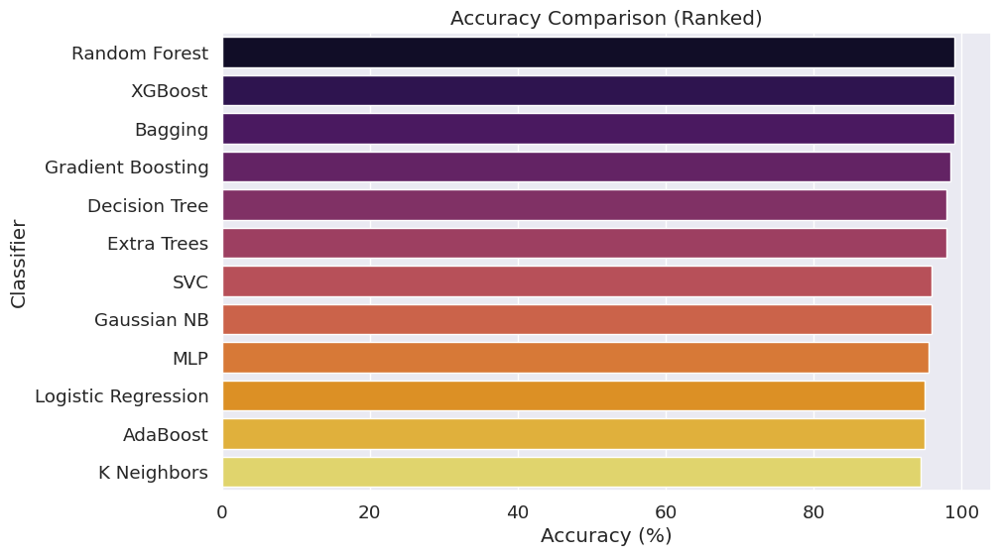

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd


classifiers = ['Logistic Regression', 'SVC', 'K Neighbors', 'Random Forest', 'Decision Tree', 'XGBoost',
               'Gradient Boosting', 'Gaussian NB', 'MLP', 'AdaBoost', 'Bagging', 'Extra Trees']

accuracies = [95.00, 96.00, 94.50, 99.00, 98.00, 99.00, 98.50, 96.00, 95.50, 95.00, 99.00, 98.00]
f1_scores = [0.95, 0.96, 0.94, 0.99, 0.98, 0.99, 0.98, 0.96, 0.95, 0.95, 0.99, 0.98]
supports = [200, 200, 200, 200, 200, 200, 200, 200, 200, 200, 200, 200]


data_dict = {'Classifier': [], 'Accuracy': [], 'F1 Score': [], 'Support': []}

for classifier, accuracy, f1_score, support in zip(classifiers, accuracies, f1_scores, supports):
    data_dict['Classifier'].append(classifier)
    data_dict['Accuracy'].append(accuracy)
    data_dict['F1 Score'].append(f1_score)
    data_dict['Support'].append(support)


data = pd.DataFrame(data_dict)


sorted_data_accuracy = data.sort_values(by='Accuracy', ascending=False)


plt.figure(figsize=(10, 6))
sns.barplot(x='Accuracy', y='Classifier', data=sorted_data_accuracy, palette='inferno')
plt.title('Accuracy Comparison (Ranked)')
plt.xlabel('Accuracy (%)')
plt.ylabel('Classifier')
plt.show()
